In [3]:
%load_ext autoreload
%reload_ext autoreload
%autoreload 2

% matplotlib inline
from __future__ import (division, 
                        print_function)

import os
import sys
import copy
import fnmatch
import warnings
import collections

import numpy as np
import scipy
try:
    from scipy.stats import scoreatpercentile
except:
    scoreatpercentile = False
from scipy.interpolate import interp1d
import cPickle as pickle
from scipy import ndimage

# Astropy
from astropy.io import fits
from astropy    import units as u
from astropy.stats import sigma_clip
from astropy.table import Table, Column
from astropy.utils.console import ProgressBar
from astropy.convolution import convolve, Box1DKernel

# AstroML
from astroML.plotting import hist
from astroML.density_estimation import KNeighborsDensity
try:
    from sklearn.neighbors import KernelDensity
    use_sklearn_KDE = True
except:
    import warnings
    warnings.warn("KDE will be removed in astroML version 0.3.  Please "
                  "upgrade to scikit-learn 0.14+ and use "
                  "sklearn.neighbors.KernelDensity.", DeprecationWarning)
    from astroML.density_estimation import KDE
    use_sklearn_KDE = False
from sklearn.neighbors import KDTree
from sklearn.neighbors import BallTree

# Matplotlib related
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('classic')
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
from matplotlib.patches import Ellipse
from matplotlib.ticker import NullFormatter, MaxNLocator, FormatStrFormatter
from matplotlib.collections import PatchCollection
tickFormat = FormatStrFormatter('$\mathbf{%g}$') 

# Personal
import hscUtils as hUtil
import galSBP
import coaddCutoutGalfitSimple as gSimple 

# Cosmology
import cosmology
c=cosmology.Cosmo(H0=70.0, omega_m=0.3, omega_l=0.7, flat=1)

# SEP 
import sep

# Color map 
from palettable.colorbrewer.sequential import Greys_9, OrRd_9, Blues_9, Purples_9, YlGn_9
BLK = Greys_9.mpl_colormap
ORG = OrRd_9.mpl_colormap
BLU = Blues_9.mpl_colormap
GRN = YlGn_9.mpl_colormap
PUR = Purples_9.mpl_colormap

# Personal tools
import galSBP as sbp
from hscUtils import songPlotSetup, removeIsNullCol
from hscUtils import confidence_interval, ma_confidence_interval_1d, confidence_interval_1d

## Constants
# SDSS pivot wavelength 
sdss_u_pivot = 3551.0
sdss_g_pivot = 4686.0
sdss_r_pivot = 6165.0
sdss_i_pivot = 7481.0
sdss_z_pivot = 8931.0

# HSC pivot wavelength 
hsc_g_pivot = 4782.2
hsc_r_pivot = 6101.7 
hsc_i_pivot = 7648.0 
hsc_z_pivot = 8883.0
hsc_y_pivot = 9750.8

hscFiltWave = np.asarray([hsc_g_pivot, hsc_r_pivot, hsc_i_pivot, hsc_z_pivot, hsc_y_pivot])

"""
Absolute magnitude of the Sun in HSC filters
Right now, just use the DES filters
"""
SUN_G = 5.08
SUN_R = 4.62
SUN_I = 4.52
SUN_Z = 4.52
SUN_Y = 4.51

# Solar stellar metallicity 
Z_SUN = 0.02

# definitions for the axes
left, width    = 0.15, 0.64
right          = left + width 
bottom, height = 0.13, 0.86
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.20, height]
SBP1 = [0.124, 0.085, 0.865, 0.33]
SBP2 = [0.124, 0.41, 0.865, 0.55]
EC1 = [0.135, 0.072, 0.862, 0.295]
EC2 = [0.135, 0.366, 0.862, 0.295]
EC3 = [0.135, 0.666, 0.862, 0.295]
REC = [0.12, 0.11, 0.87, 0.87]
COG1 = [0.143, 0.10, 0.850, 0.43]
COG2 = [0.143, 0.53, 0.850, 0.43]

# Universal RSMA array
RSMA_COMMON = np.arange(0.4, 4.2, 0.01)
RR50_COMMON = np.arange(0.0, 9.0, 0.01)
EMPTY = (RSMA_COMMON * np.nan)

# Color 
BLUE0 = "#92c5de"
BLUE1 = "#0571b0"
RED0 = "#f4a582"
RED1 = "#ca0020"
PURPLE0 = '#af8dc3'
PURPLE1 = '#762a83'
BROWN0 = '#bf812d'
BROWN1 = '#543005'
GREEN0 = '#7fbf7b'
GREEN1 = '#1b7837'

# 3-sigma
SIGMA1 = 0.3173
SIGMA2 = 0.0455
SIGMA3 = 0.0027


# Cubehelix
from palettable.cubehelix import Cubehelix
CUBE = Cubehelix.make(start=0.3, rotation=-0.5, n=16).mpl_colormap

import itertools

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [48]:
def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None

# Catalog and File Names

In [4]:
imgDir = 'example'

In [5]:
ls example

all_xray_imag_lt_23.fits* map_gas_halo.fits*        map_stellar_halo.fits*
map_darkmatter_halo.fits* map_stellar_central.fits*


In [6]:
#isophote = '/iraf/iraf/extern/stsdas/bin.macosx/x_isophote.e'
#xttools = '/iraf/iraf/extern/tables/bin.macosx/x_ttools.e'
isophote = '/Users/song/anaconda/pkgs/iraf-2.16.1-0/variants/common/iraf/stsci_iraf/stsdas/bin.macosx/x_isophote.e'
xttools = '/Users/song/anaconda/pkgs/iraf-2.16.1-0/variants/common/iraf/stsci_iraf/tables/bin.macosx/x_ttools.e'

# The Gaussian kernal used for convolution
kernel1 = np.asarray([[0.560000, 0.980000, 0.560000],
                      [0.980000, 1.000000, 0.980000],
                      [0.560000, 0.980000, 0.560000]])

kernel2 = np.asarray([[0.000000, 0.220000, 0.480000, 0.220000, 0.000000],
                      [0.220000, 0.990000, 1.000000, 0.990000, 0.220000],
                      [0.480000, 1.000000, 1.000000, 1.000000, 0.480000],
                      [0.220000, 0.990000, 1.000000, 0.990000, 0.220000],
                      [0.000000, 0.220000, 0.480000, 0.220000, 0.000000]])

kernel3 = np.asarray([[0.092163, 0.221178, 0.296069, 0.221178, 0.092163],
                      [0.221178, 0.530797, 0.710525, 0.530797, 0.221178],
                      [0.296069, 0.710525, 0.951108, 0.710525, 0.296069],
                      [0.221178, 0.530797, 0.710525, 0.530797, 0.221178],
                      [0.092163, 0.221178, 0.296069, 0.221178, 0.092163]])

In [5]:
len(cat)

37.857142857142854

# Example mass maps

In [8]:
imgMs = fits.open('example/map_stellar_central.fits')[0].data
headMs = fits.open('example/map_stellar_central.fits')[0].header

imgMd = fits.open('example/map_stellar_halo.fits')[0].data
imgMg = fits.open('example/map_gas_halo.fits')[0].data
imgMh = fits.open('example/map_darkmatter_halo.fits')[0].data

In [26]:
print(imgMs.shape, imgMd.shape, imgMg.shape, imgMh.shape)

example = [imgMs, imgMd, imgMg, imgMh]
labels = [r'$\mathrm{Stellar\ Mass\ (Central)}$', 
          r'$\mathrm{Stellar\ Mass\ (Halo)}$',
          r'$\mathrm{Gas\ Map}$',
          r'$\mathrm{Dark\ Matter\ Map}$']
exampleFile = ['example/map_stellar_central.fits', 
               'example/map_stellar_halo.fits',
               'example/map_gas_halo.fits',
               'example/map_darkmatter_halo.fits']
print(len(example))

(162, 162) (162, 162) (162, 162) (162, 162)
4


In [51]:
h0 = 0.7
scale = 1.86 / h0 # kpc

cenX, cenY = 81.0, 81.0

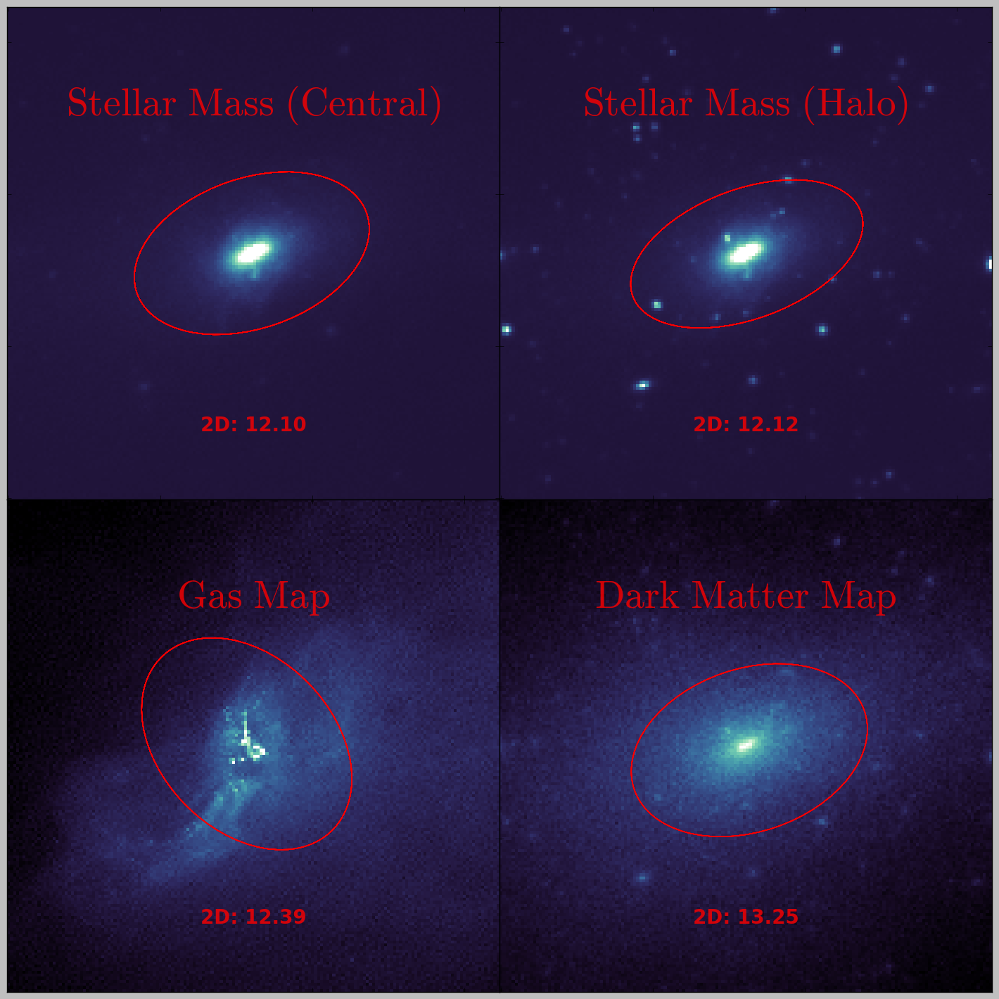

In [52]:
# Prepare the 
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(2, 2)
gs.update(wspace=0.0, hspace=0.00)

xArr, yArr, baArr, paArr, m10Arr, m30Arr, m100Arr, mtotArr = [], [], [], [], [], [], [], []
m150Arr, m200Arr = [], []
aperProf, aperMass = [], []
r50Arr = []

with ProgressBar(len(example)) as bar:
    for item in enumerate(example):
        ii, img = item
        bar.update()

        imgN = img.byteswap().newbyteorder()

        # Extract objects
        bkg = sep.Background(imgN, bw=20, bh=20, fw=4, fh=4)
        imgSub = imgN - bkg
        objects = sep.extract(imgSub, 15.0, filter_kernel=kernel3)

        # Find the object at the center
        if len(objects) == 1: 
            index = 0
        else: 
            index = np.argmin(np.sqrt((objects['x'] - cenX) ** 2.0 + (objects['y'] - cenY) ** 2.0))

        # Get the naive ba, theta, xcen, ycen
        ba = objects[index]['b'] / objects[index]['a']
        theta = objects[index]['theta']
        xcen, ycen = objects[index]['x'], objects[index]['y']
        baArr.append(ba)
        paArr.append(theta * 180.0 / np.pi)
        xArr.append(xcen)
        yArr.append(ycen)

        # Aperture photometry and naive "profiles"
        rad = np.linspace(1.2, 4.0, 50)
        kpc = (rad ** 4.0)
        pix = (kpc / scale)
        area = (np.pi * (kpc ** 2.0) * ba)
        maper = sep.sum_ellipse(imgN, xcen, ycen, pix, pix * ba, theta, 1.0, 
                                bkgann=None, subpix=11)[0]
        mring = maper[1:] - maper[0:-1]
        aring = area[1:] - area[0:-1]
        rho = np.log10(mring / aring)
        aperMass.append(maper)
        aperProf.append(rho)
        
        # Mass within different apertures
        rad = np.asarray([10.0, 30.0, 100.0, 150.0, 200.0]) / scale
        maper = sep.sum_ellipse(imgN, xcen, ycen, rad, rad * ba, theta, 1.0, 
                                bkgann=None, subpix=11)[0]
        m10Arr.append(np.log10(maper[0]))
        m30Arr.append(np.log10(maper[1]))
        m100Arr.append(np.log10(maper[2]))
        m150Arr.append(np.log10(maper[3]))
        m200Arr.append(np.log10(maper[4]))
        mtotArr.append(np.log10(np.sum(imgN)))
        
        # Get r50 
        r50, flag = sep.flux_radius(imgN, xcen, ycen, 30.0, 0.5,
                                    subpix=11)
        r50Arr.append(r50 * scale)

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgN), np.std(imgN)
        im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')

        # plot an ellipse for each object
        for i in range(len(objects)):
            e = Ellipse(xy=(xcen, ycen),
                        width=40 * 2.0,
                        height=(40 * 2.0 * ba),
                        angle=(theta * 180. / np.pi))
            e.set_facecolor('none')
            e.set_edgecolor('r')
            e.set_alpha(0.5)
            e.set_linewidth(1.0)
            ax.add_artist(e)
        ax.set_aspect('equal')
        
        # Show the 2D and 3D mass within 100 kpc 
        ax.text(0.5, 0.90, labels[ii], 
                verticalalignment='center', horizontalalignment='center',
                fontsize=40.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
        ax.text(0.5, 0.15, "2D: %5.2f" % np.log10(maper[3]), 
                verticalalignment='center', horizontalalignment='center',
                fontsize=20.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
    
fig.savefig('mblack2_map_aperture_example.pdf', dpi=90)

In [53]:
baArr[0], paArr[0]

(0.61672132801398216, 19.187912123986127)

!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!


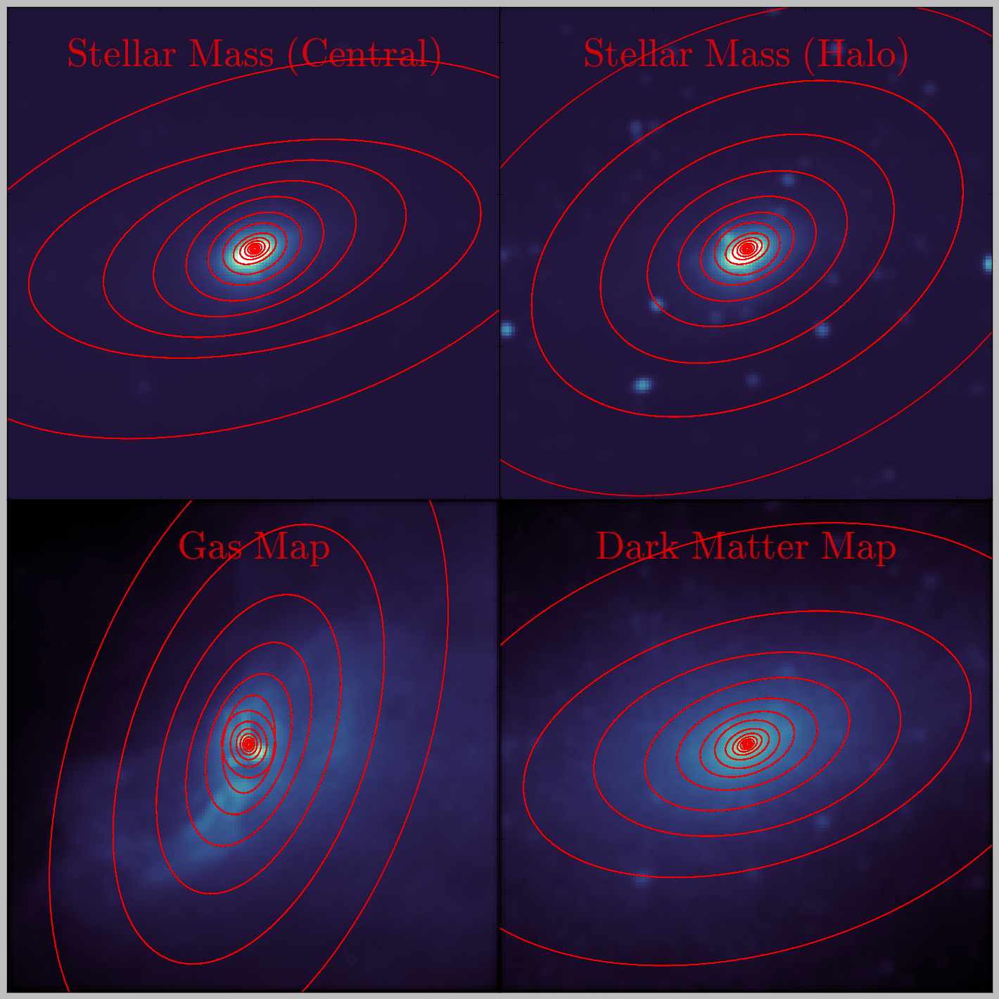

In [54]:
# Prepare the plot
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(2, 2)
gs.update(wspace=0.0, hspace=0.00)

xArr, yArr, ba1Arr, pa1Arr, ba2Arr, pa2Arr, ba3Arr, pa3Arr = [], [], [], [], [], [], [], []
smaProf, ellProf, paProf, sbpProf = [], [], [], []

with ProgressBar(len(exampleFile)) as bar:
    for item in enumerate(exampleFile):
        ii, name = item
        img = example[ii]
        bar.update()

        # Convert the mass density map to just mass maps
        imgSave = name.replace('.fits', '_conv.fits')
        
        imgN = img.byteswap().newbyteorder()
        imgC = ndimage.convolve(imgN, kernel2, mode='constant', cval=0.0) 
        
        hdu = fits.PrimaryHDU(imgC)
        hdulist = fits.HDUList([hdu])
        hdulist.writeto(imgSave, overwrite=True)

        try:
            ellOut, binOut = galSBP.galSBP(imgSave, galX=cenX, galY=cenY, 
                                           maxSma=120.0, iniSma=15.0, 
                                           verbose=False, savePng=False, saveOut=False,
                                           useZscale=False, expTime=1.0, 
                                           pix=scale, zpPhoto=0.0,
                                           galQ=baArr[0], galPA=paArr[0], 
                                           stage=2, minSma=0.5, ellipStep=0.08,
                                           isophote=isophote, xttools=xttools, 
                                           uppClip=9.0, lowClip=9.0, fracBad=0.6,
                                           harmonics="none", maxTry=9, olthresh=0.2,
                                           nClip=0, intMode='median', updateIntens=False)
        except Exception:
            ellOut, binOut = None, None

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgC), np.std(imgC)
        im = ax.imshow(imgC, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')
        
        if ellOut is not None:
            # Estimate the average ellipticity and position angle 
            sma = ellOut['sma']
            kpc = sma * scale
            xArr.append(ellOut[1]['x0'])
            yArr.append(ellOut[1]['y0'])

            avgEll1 = np.nanmedian(ellOut['ell'][(kpc > 6.0) & (kpc < 30.0)])
            avgPA1 = np.nanmedian(ellOut['pa'][(kpc > 6.0) & (kpc < 30.0)])
            ba1Arr.append(1.0 - avgEll1)
            pa1Arr.append(avgPA1)
            avgEll2 = np.nanmedian(ellOut['ell'][(kpc > 30.0) & (kpc < 50.0)])
            avgPA2 = np.nanmedian(ellOut['pa'][(kpc > 30.0) & (kpc < 50.0)])
            ba2Arr.append(1.0 - avgEll2)
            pa2Arr.append(avgPA2)
            avgEll3 = np.nanmedian(ellOut['ell'][(kpc > 50.0) & (kpc < 120.0)])
            avgPA3 = np.nanmedian(ellOut['pa'][(kpc > 50.0) & (kpc < 120.0)])
            ba3Arr.append(1.0 - avgEll3)
            pa3Arr.append(avgPA3)

            # Ellipticity and position angle profiles
            smaProf.append(np.asarray(kpc))
            ellProf.append(np.asarray(ellOut['ell']))
            paProf.append(np.asarray(ellOut['pa']))
            sbpProf.append(np.asarray(ellOut['sbp']))

            # plot an ellipse for each object
            for i in range(len(objects)):
                for k, iso in enumerate(ellOut):
                    if k % 5 == 0:
                        e = Ellipse(xy=(iso['x0'], iso['y0']),
                                    height=iso['sma'] * 2.0,
                                    width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                    angle=iso['pa'])
                    e.set_facecolor('none')
                    e.set_edgecolor('r')
                    e.set_alpha(0.20)
                    ax.add_artist(e)
            ax.set_aspect('equal')
        else: 
            xArr.append(None)
            yArr.append(None)
            ba1Arr.append(None)
            pa1Arr.append(None)
            ba2Arr.append(None)
            pa2Arr.append(None)            
            ba3Arr.append(None)
            pa3Arr.append(None)
            smaProf.append(None)
            ellProf.append(None)
            paProf.append(None)
            sbpProf.append(None)            
            
        ax.text(0.5, 0.9, labels[ii], 
                verticalalignment='center', horizontalalignment='center',
                fontsize=40.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
            
fig.savefig('mblack2_map_ell_2_example.pdf', dpi=90)

In [55]:
print(ba1Arr[0], pa1Arr[0])
print(ba2Arr[0], pa2Arr[0])
print(ba3Arr[0], pa3Arr[0])

0.6492024 -66.13204
0.68869925 -64.757375
0.6090984 -67.93168


In [56]:
print(xArr[0], yArr[0])

81.0 82.0


In [68]:
print(scale)

2.65714285714


!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!


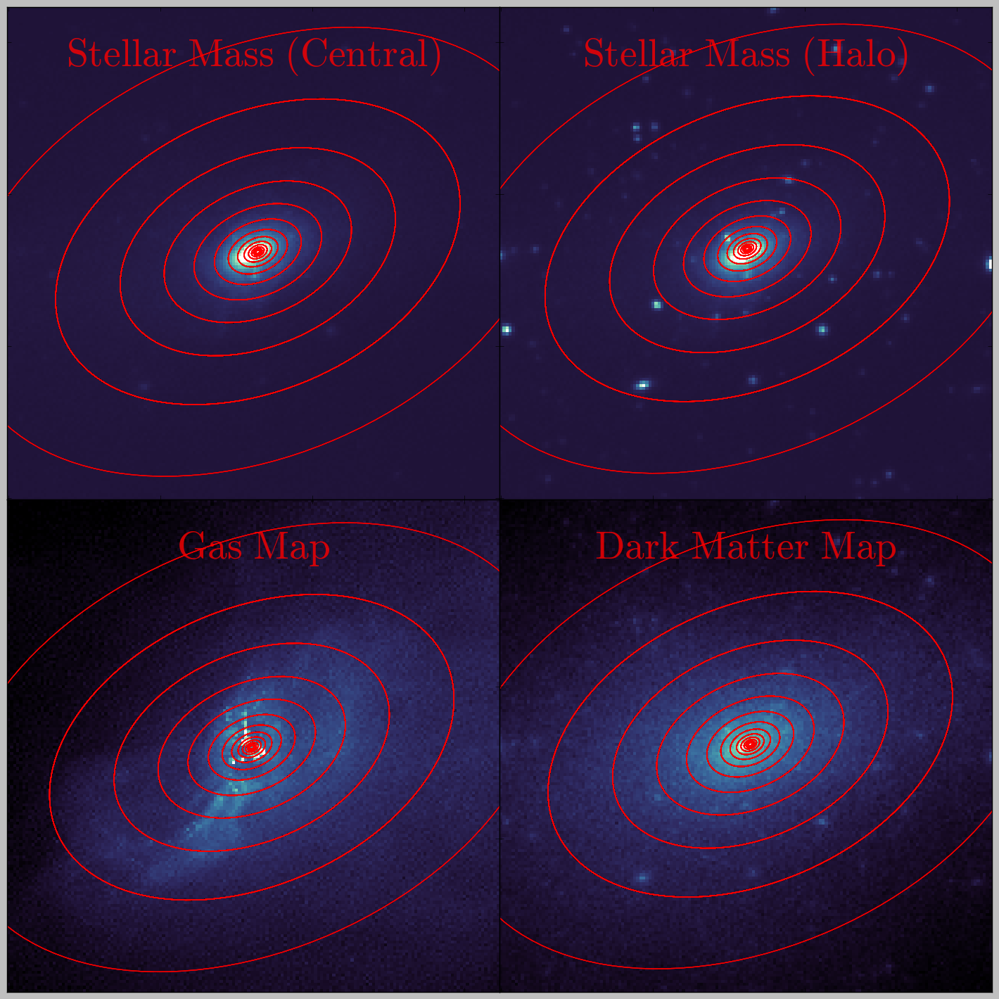

In [67]:
# Prepare the plot
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(2, 2)
gs.update(wspace=0.0, hspace=0.00)

smaProf1, sbpProf1, cogProf1 = [], [], []

with ProgressBar(len(exampleFile)) as bar:
    for item in enumerate(exampleFile):
        ii, name = item
        img = example[ii]
        bar.update()

        # Convert the mass density map to just mass maps
        imgN = img.byteswap().newbyteorder()
        imgC = copy.copy(imgN)
        
        try:
            baUse = ba1Arr[0]
            paUse = hUtil.normAngle(pa1Arr[0], lower=-90, upper=90, b=True)
            ellOut, binOut = galSBP.galSBP(name, 
                                           galX=xArr[0], galY=yArr[0], 
                                           maxSma=108, iniSma=15.0, 
                                           verbose=False, savePng=False, saveOut=False,
                                           useZscale=False, expTime=1.0, pix=scale, zpPhoto=0.0,
                                           galQ=baUse, galPA=paUse, 
                                           stage=3, minSma=0.0, ellipStep=0.08,
                                           isophote=isophote, xttools=xttools, 
                                           fracBad=0.6, uppClip=6.0, lowClip=6.0, maxTry=9,
                                           nClip=0, intMode='median', updateIntens=False)
        except Exception:
            ellOut, binOut = None, None

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgC), np.std(imgC)
        im = ax.imshow(imgC, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')
        
        if ellOut is not None:
            sma = ellOut['sma']
            kpc = sma * scale
            
            smaProf1.append(np.asarray(kpc))
            cogProf1.append(np.asarray(ellOut['growth_cor']))
            sbpProf1.append(np.asarray(ellOut['sbp']) / -2.5)

            # plot an ellipse for each object
            for i in range(len(objects)):
                for k, iso in enumerate(ellOut):
                    if k % 5 == 0:
                        e = Ellipse(xy=(iso['x0'], iso['y0']),
                                    height=iso['sma'] * 2.0,
                                    width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                    angle=iso['pa'])
                    e.set_facecolor('none')
                    e.set_edgecolor('r')
                    e.set_alpha(0.20)
                    ax.add_artist(e)
            ax.set_aspect('equal')
        else: 
            smaProf1.append(None)
            cogProf1.append(None)
            sbpProf1.append(None)
            
        ax.text(0.5, 0.9, labels[ii], 
                verticalalignment='center', horizontalalignment='center',
                fontsize=40.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
            
fig.savefig('mblack2_map_ell_3_example.pdf', dpi=90)

In [49]:
hscAvgProf0 = loadPkl("hscAvgProf0.pkl")
hscAvgProf1 = loadPkl("hscAvgProf1.pkl")
hscAvgProf2 = loadPkl("hscAvgProf2.pkl")

rm0_sl, rm0_ml, rm0_aml = hscAvgProf0['all'], hscAvgProf0['med'], hscAvgProf0['avg']
rm1_sl, rm1_ml, rm1_aml = hscAvgProf1['all'], hscAvgProf1['med'], hscAvgProf1['avg']
rm2_sl, rm2_ml, rm2_aml = hscAvgProf2['all'], hscAvgProf2['med'], hscAvgProf2['avg']

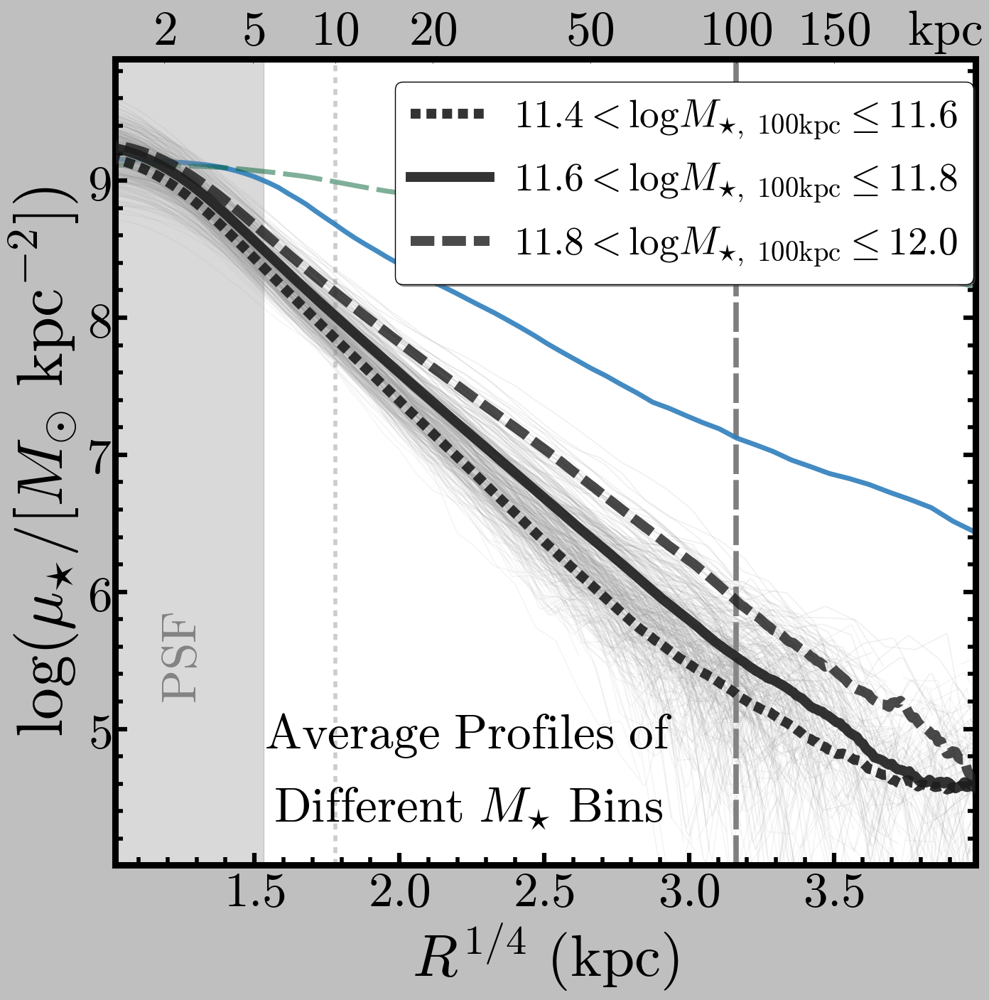

In [66]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
label1="$11.4 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.6$"
label2="$11.6 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.8$"
label3="$11.8 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 12.0$"
showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'
# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.13, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm0_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, aa, c=color1a, alpha=0.10, linewidth=1.1)
for ii, bb in enumerate(rm1_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, bb, c=color1a, alpha=0.15, linewidth=1.1)
for ii, cc in enumerate(rm2_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, cc, c=color1a, alpha=0.15, linewidth=1.1)
    # --------------------------------------------------------------------------------------- #
## Median profiles
ax1.plot(RSMA_COMMON, rm0_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1, dashes=(10,6))
ax1.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label2)
ax1.plot(RSMA_COMMON, rm2_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=label3, dashes=(24,8))

# ========= #
ax1.plot((smaProf1[0] * 1.0) ** 0.25, sbpProf1[0],
         linestyle='-', linewidth=5.0, 
         c=BLU(0.7), alpha=0.9, zorder=0)
#ax1.plot((smaProf1[1] * 0.7) ** 0.25, sbpProf1[1],
#         linestyle='-', linewidth=3.0, 
#         c=BLU(0.9), alpha=0.4, zorder=0)
ax1.plot((smaProf1[3] * 1.0) ** 0.25, sbpProf1[3],
         linestyle='--', linewidth=5.0, 
         c=GRN(0.9), alpha=0.5, zorder=0, dashes=(40,8))
# ========= #

# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=65)
    ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(0.325, 0.72), shadow=True, fancybox=True, 
               numpoints=1, fontsize=40, scatterpoints=1, 
               markerscale=1.2, borderpad=0.4, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(xmin, xmax)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax2.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax2.transAxes)
# --------------------------------------------------------------------------------------- #
ax1.text(0.41, 0.13, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
ax1.text(0.41, 0.04, '$\mathrm{Different\ }M_{\star}\ \mathrm{Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
# --------------------------------------------------------------------------------------- #
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

fig.savefig('mblack2_average_mass_profiles_example.pdf', dpi=90)
plt.show()

# Estimate the average shape and ellipticity profiles 

## Center and Average Shape Using SEP

In [6]:
cenX, cenY = 200.0, 200.0
scale = 1.0

In [17]:
# Prepare the 
fig = plt.figure(figsize=(14, 76))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(38, 7)
gs.update(wspace=0.0, hspace=0.00)

xArr, yArr, baArr, paArr, m10Arr, m30Arr, m100Arr, mtotArr = [], [], [], [], [], [], [], []
m150Arr, m200Arr = [], []
aperProf, aperMass = [], []
r50Arr = []

with ProgressBar(len(e)) as bar:
    for item in enumerate(cat):
        ii, col = item
        bar.update()

        imgN = img.byteswap().newbyteorder()

        # Extract objects
        bkg = sep.Background(imgN, bw=20, bh=20, fw=4, fh=4)
        imgSub = imgN - bkg
        objects = sep.extract(imgSub, 15.0, filter_kernel=kernel3)

        # Find the object at the center
        if len(objects) == 1: 
            index = 0
        else: 
            index = np.argmin(np.sqrt((objects['x'] - cenX) ** 2.0 + (objects['y'] - cenY) ** 2.0))

        #print(len(objects), index)

        # Get the naive ba, theta, xcen, ycen
        ba = objects[index]['b'] / objects[index]['a']
        theta = objects[index]['theta']
        xcen, ycen = objects[index]['x'], objects[index]['y']
        baArr.append(ba)
        paArr.append(theta * 180.0 / np.pi)
        xArr.append(xcen)
        yArr.append(ycen)

        # Aperture photometry and naive "profiles"
        rad = np.linspace(1.2, 4.0, 50)
        kpc = (rad ** 4.0)
        pix = (kpc / scale)
        area = (np.pi * (kpc ** 2.0) * ba)
        maper = sep.sum_ellipse(imgN, xcen, ycen, pix, pix * ba, theta, 1.0, 
                                bkgann=None, subpix=11)[0]
        mring = maper[1:] - maper[0:-1]
        aring = area[1:] - area[0:-1]
        rho = np.log10(mring / aring)
        aperMass.append(maper)
        aperProf.append(rho)
        
        # Mass within different apertures
        rad = np.asarray([10.0, 30.0, 100.0, 150.0, 200.0]) / scale
        maper = sep.sum_ellipse(imgN, xcen, ycen, rad, rad * ba, theta, 1.0, 
                                bkgann=None, subpix=11)[0]
        m10Arr.append(np.log10(maper[0]))
        m30Arr.append(np.log10(maper[1]))
        m100Arr.append(np.log10(maper[2]))
        m150Arr.append(np.log10(maper[3]))
        m200Arr.append(np.log10(maper[4]))
        mtotArr.append(np.log10(np.sum(imgN)))
        
        # Get r50 
        r50, flag = sep.flux_radius(imgN, xcen, ycen, 30.0, 0.5,
                                    subpix=11)
        r50Arr.append(r50 * scale)

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgN), np.std(imgN)
        im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')

        # plot an ellipse for each object
        for i in range(len(objects)):
            e = Ellipse(xy=(xcen, ycen),
                        width=40 * 2.0,
                        height=(40 * 2.0 * ba),
                        angle=(theta * 180. / np.pi))
            e.set_facecolor('none')
            e.set_edgecolor('r')
            e.set_alpha(0.5)
            e.set_linewidth(1.0)
            ax.add_artist(e)
        ax.set_aspect('equal')
        
        ax.text(0.5, 0.15, "2D: %5.2f" % np.log10(maper[3]), 
                verticalalignment='center', horizontalalignment='center',
                fontsize=20.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
    

NameError: name 'cat' is not defined

In [11]:
cat.add_column(Column(xArr, name='xCen_aper'))
cat.add_column(Column(yArr, name='yCen_aper'))
cat.add_column(Column(baArr, name='ba_aper'))
cat.add_column(Column(paArr, name='pa_aper'))
cat.add_column(Column(m10Arr, name='m10_aper'))
cat.add_column(Column(m30Arr, name='m30_aper'))
cat.add_column(Column(m100Arr, name='m100_aper'))
cat.add_column(Column(m150Arr, name='m150_aper'))
cat.add_column(Column(m200Arr, name='m200_aper'))
#cat.remove_column('r50_aper')
cat.add_column(Column(r50Arr, name='r50_aper'))
#cat.remove_column('sbp_aper')
cat.add_column(Column(aperProf, name='sbp_aper'))
cat.add_column(Column(aperMass, name='mass_aper'))

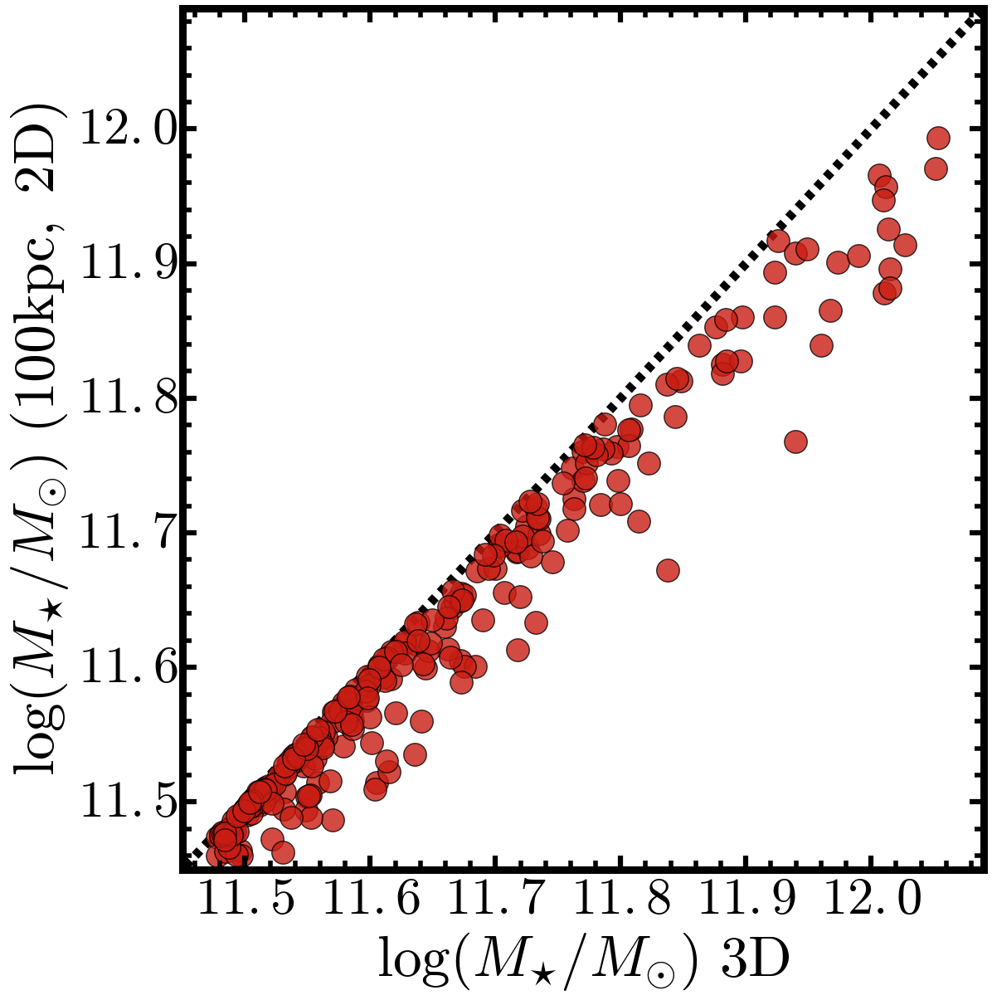

In [9]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(np.log10(cat['col6']), cat['m100_aper'], 
            s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ \mathrm{3D}$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{2D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.45, 12.09)
ax1.set_ylim(11.45, 12.09)

fig.savefig('horizon_mass_compare_m100_z0.37.pdf', dpi=90)

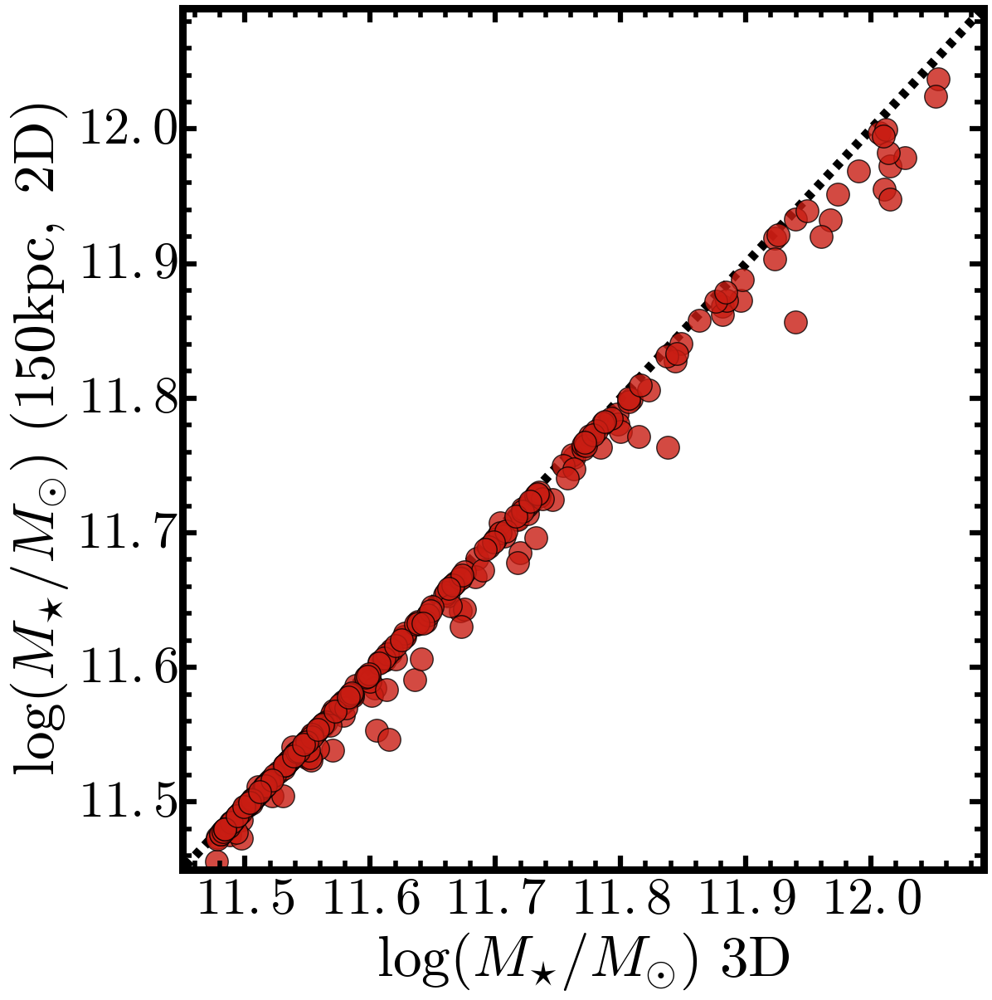

In [10]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(np.log10(cat['col6']), cat['m150_aper'], 
            s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ \mathrm{3D}$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (150 \mathrm{kpc},\ \mathrm{2D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.45, 12.09)
ax1.set_ylim(11.45, 12.09)

fig.savefig('horizon_mass_compare_m150_z0.37.pdf', dpi=90)

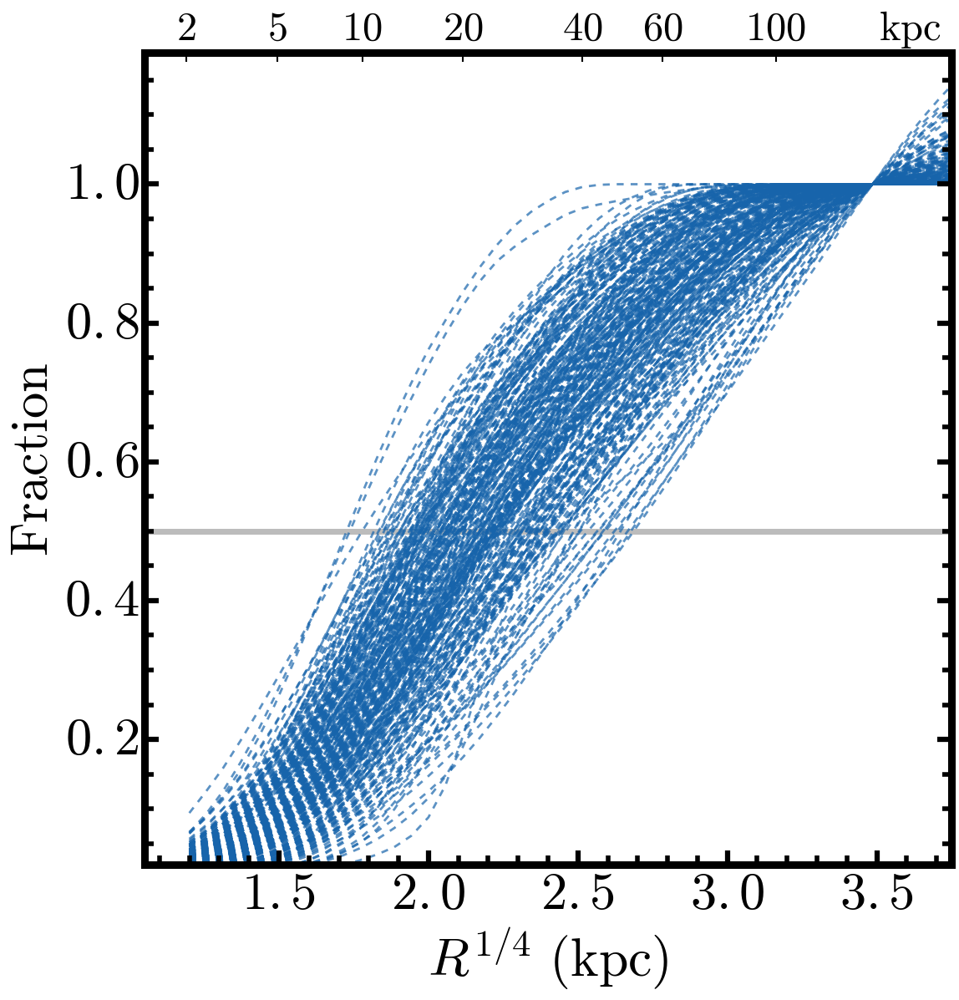

In [12]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

rad = np.linspace(1.2, 4.0, 50)
kpc = (rad ** 4.0)
pix = (kpc / 5.0)

r50Arr = []
# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.940,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

for gal in cat:
    mProf = gal['mass_aper']
    mMax = np.nanmax(mProf[(kpc <= 150.0)])
    fracMax = (mProf / mMax)
    fracInterp = interp1d(fracMax, kpc)
    r50 = fracInterp(0.50)
    r50Arr.append(r50)
    ax1.plot(kpc ** 0.25, mProf / mMax, linestyle='--', linewidth=2, c=BLU(0.8), alpha=0.7)
    
ax1.axhline(0.5, linestyle='-', linewidth=5.0, c=BLK(0.6), alpha=0.5, zorder=0)

## Label
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=46)
ax1.set_ylabel('$\mathrm{Fraction}$', size=45)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(1.05, 3.75)
ax1.set_ylim(0.02, 1.19)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0, 60.0, 100.0]
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(1.05, 3.75)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=35)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.91, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=35.0, transform=ax1b.transAxes)

fig.savefig('horizon_cog_fraction_hres_z0.37.pdf', dpi=90)

In [13]:
cat.add_column(Column(np.asarray(r50Arr), name='r50_prof'))

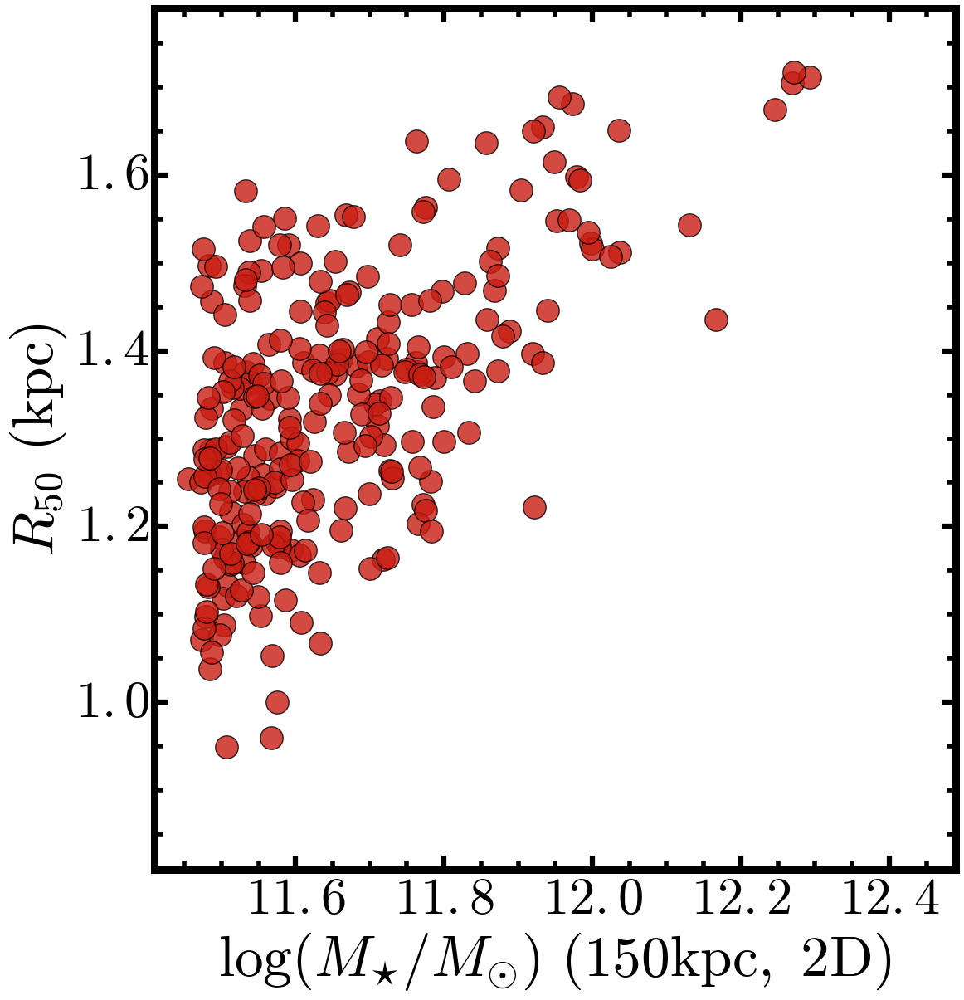

In [13]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['m150_aper'], np.log10(cat['r50_prof']), 
            s=390, c=ORG(0.8), alpha=0.8)

#ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (150 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$R_{50}\ (\mathrm{kpc})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.41, 12.49)
ax1.set_ylim(0.81, 1.79)

fig.savefig('horizon_m100_r50_hres_z0.37.pdf', dpi=90)

## SEP run using Circular Aperture

/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:38: RuntimeWarning: divide by zero encountered in log10


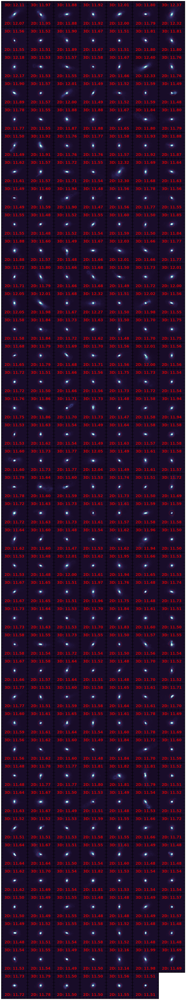

In [14]:
# Prepare the plot
fig = plt.figure(figsize=(14, 76))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(38, 7)
gs.update(wspace=0.0, hspace=0.00)

m10ArrC, m30ArrC, m100ArrC = [], [], []
m150ArrC, m200ArrC = [], []
aperProfC, aperMassC = [], []

with ProgressBar(len(cat)) as bar:
    for item in enumerate(cat):
        ii, col = item
        galID = col['col1']
        bar.update()
        #print("## Deal with galaxy : %s" % galID)

        # Convert the mass density map to just mass maps
        imgTest = os.path.join(imgDir, 'galaxy_{:03d}'.format(galID) + '.fits')
        
        imgN = fits.open(imgTest)[0].data
        imgN = imgN.byteswap().newbyteorder()
        
        xcen = col['xCen_aper']
        ycen = col['yCen_aper']

        # Aperture photometry and naive "profiles"
        rad = np.linspace(1.2, 4.0, 50)
        kpc = (rad ** 4.0)
        pix = (kpc / scale)
        area = (np.pi * (kpc ** 2.0) * ba)
        maper = sep.sum_ellipse(imgN, xcen, ycen, pix, pix, 0.0, 1.0, 
                                bkgann=None, subpix=11)[0]
        mring = maper[1:] - maper[0:-1]
        aring = area[1:] - area[0:-1]
        rho = np.log10(mring / aring)
        aperMassC.append(maper)
        aperProfC.append(rho)

        # Mass within different apertures
        rad = np.asarray([10.0, 30.0, 100.0, 150.0, 200.0]) / scale
        maper = sep.sum_ellipse(imgN, xcen, ycen, rad, rad, 0.0, 1.0, 
                                bkgann=None, subpix=11)[0]
        m10ArrC.append(np.log10(maper[0]))
        m30ArrC.append(np.log10(maper[1]))
        m100ArrC.append(np.log10(maper[2]))
        m150ArrC.append(np.log10(maper[3]))
        m200ArrC.append(np.log10(maper[4]))

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgN), np.std(imgN)
        im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.0*s, vmax=m+10*s, origin='lower')

        # plot an ellipse for each object
        for i in range(len(objects)):
            e = Ellipse(xy=(xcen, ycen),
                        width=40 * 2.0,
                        height=(40 * 2.0),
                        angle=0.0)
            e.set_facecolor('none')
            e.set_edgecolor('r')
            e.set_alpha(0.5)
            e.set_linewidth(1.0)
            ax.add_artist(e)
        ax.set_aspect('equal')
        
        # Show the 2D and 3D mass within 100 kpc 
        ax.text(0.5, 0.85, "3D: %5.2f" % np.log10(col['col6']), 
                verticalalignment='center', horizontalalignment='center',
                fontsize=20.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
        ax.text(0.5, 0.15, "2D: %5.2f" % np.log10(maper[3]), 
                verticalalignment='center', horizontalalignment='center',
                fontsize=20.0, transform=ax.transAxes, weight='bold', 
                color='r', alpha=0.8)
    
fig.savefig('horizon_map_apertureC_z0.37.pdf', dpi=120)

In [15]:
cat.add_column(Column(m10ArrC, name='m10c_aper'))
cat.add_column(Column(m30ArrC, name='m30c_aper'))
cat.add_column(Column(m100ArrC, name='m100c_aper'))
cat.add_column(Column(m150ArrC, name='m150c_aper'))
cat.add_column(Column(m200ArrC, name='m200c_aper'))

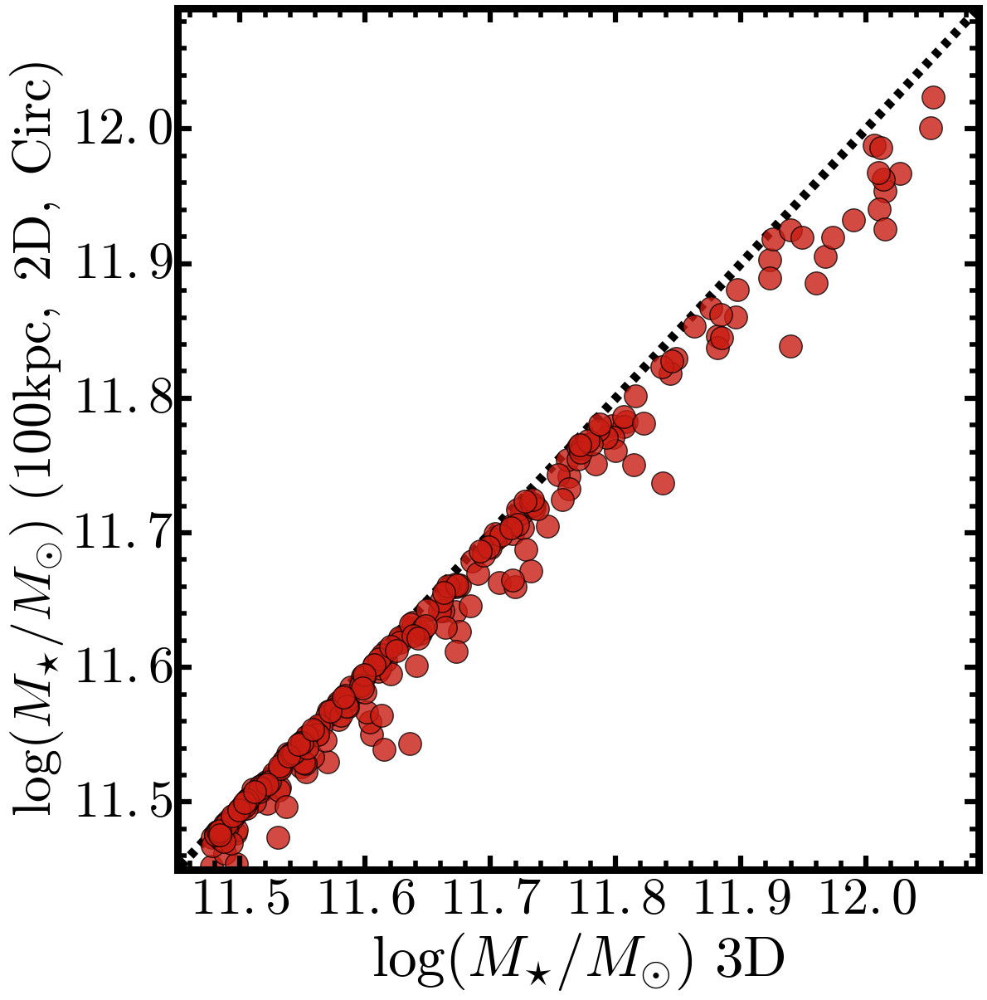

In [16]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(np.log10(cat['col6']), cat['m100c_aper'], 
            s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ \mathrm{3D}$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{2D,\ Circ})$', size=46)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.45, 12.09)
ax1.set_ylim(11.45, 12.09)

fig.savefig('horizon_m100c_compare_z0.37.pdf', dpi=90)

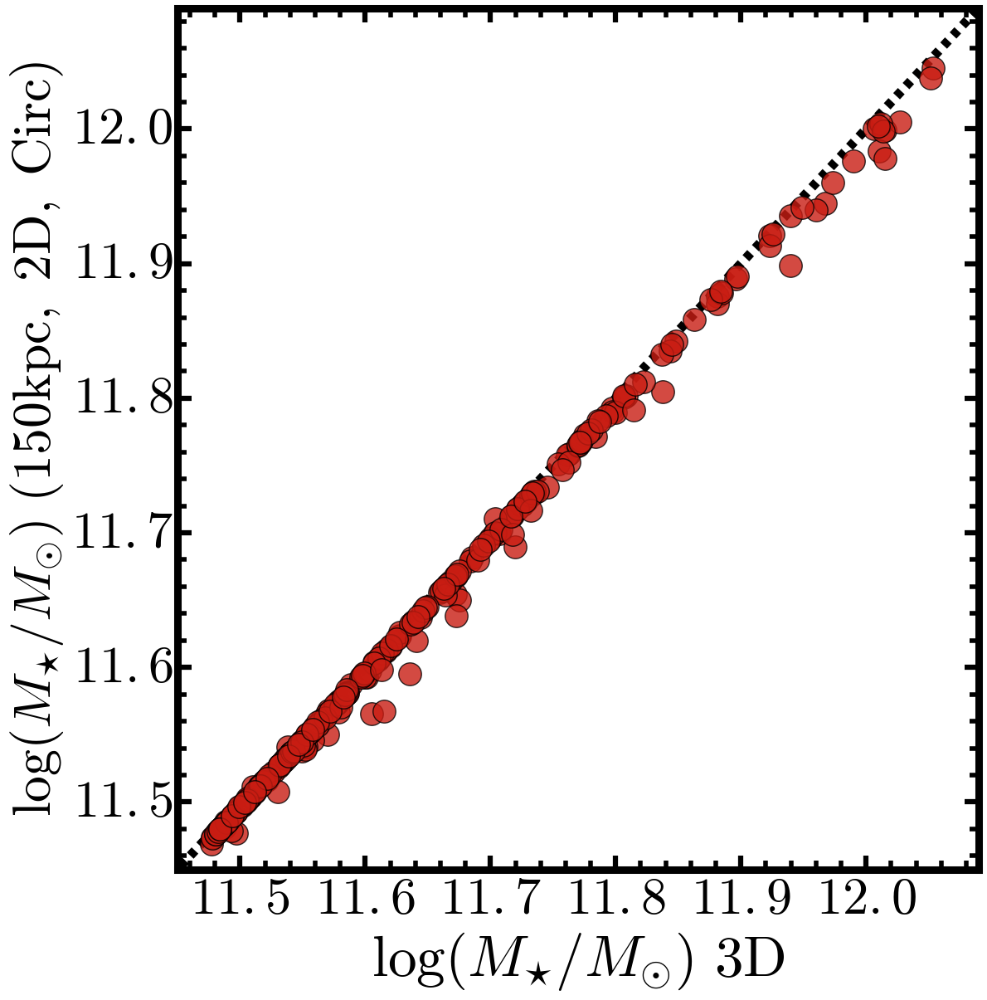

In [17]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(np.log10(cat['col6']), cat['m150c_aper'], 
            s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ \mathrm{3D}$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (150 \mathrm{kpc},\ \mathrm{2D,\ Circ})$', size=46)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.45, 12.09)
ax1.set_ylim(11.45, 12.09)

fig.savefig('horizon_m150c_compare_z0.37.pdf', dpi=90)

## Extract the Ellipticity Profile

/Users/song/anaconda/lib/python2.7/site-packages/numpy/lib/polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)
/Users/song/anaconda/lib/python2.7/site-packages/numpy/lib/polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)
/Users/song/Dropbox/work/project/hs_hsc/py/galsbp/galSBP.py:577: RuntimeWarning: divide by zero encountered in log10
  sbpOri = zp - 2.5 * np.log10(intensOri / (pixArea * exptime))
/Users/song/Dropbox/work/project/hs_hsc/py/galsbp/galSBP.py:578: RuntimeWarning: divide by zero encountered in log10
  sbpSub = zp - 2.5 * np.log10(intensSub / (pixArea * exptime))
/Users/song/Dropbox/work/project/hs_hsc/py/galsbp/galSBP.py:588: RuntimeWarning: divide by zero encountered in log10
  (pixArea * exptime))
/Users/song/Dropbox/work/project/hs_hsc/py/galsbp/galSBP.py:589: RuntimeWarning: invalid value encountered in subtract
  sbp_err = (sbpSub - sbp_low)
/Users/song/Dropbox/work/proje

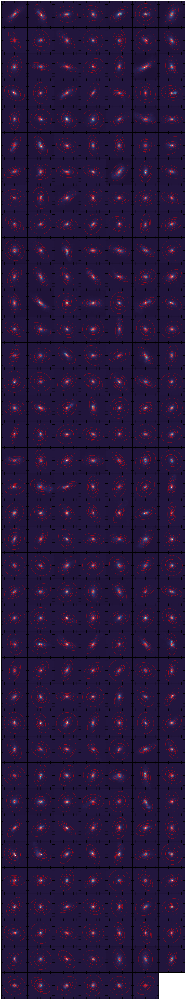

In [18]:
# Prepare the plot
fig = plt.figure(figsize=(14, 76))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(38, 7)
gs.update(wspace=0.0, hspace=0.00)

xArr, yArr, ba1Arr, pa1Arr, ba2Arr, pa2Arr, ba3Arr, pa3Arr = [], [], [], [], [], [], [], []
smaProf, ellProf, paProf, sbpProf = [], [], [], []

with ProgressBar(len(cat)) as bar:
    for item in enumerate(cat):
        ii, col = item
        galID = col['col1']
        bar.update()

        # Convert the mass density map to just mass maps
        imgTest = os.path.join(imgDir, 'galaxy_{:03d}'.format(galID) + '.fits')
        imgSave = os.path.join(imgDir, 'galaxy_{:03d}'.format(galID) + '_conv.fits')
        
        imgN = fits.open(imgTest)[0].data
        imgN = imgN.byteswap().newbyteorder()
        imgC = ndimage.convolve(imgN, kernel2, mode='constant', cval=0.0) 
        
        hdu = fits.PrimaryHDU(imgC)
        hdulist = fits.HDUList([hdu])
        hdulist.writeto(imgSave, clobber=True)

        try:
            ellOut, binOut = galSBP.galSBP(imgSave, galX=cenX, galY=cenY, 
                                           maxSma=200, iniSma=15.0, 
                                           verbose=False, savePng=False, saveOut=False,
                                           useZscale=False, expTime=1.0, pix=scale, zpPhoto=0.0,
                                           galQ=col['ba_aper'], galPA=col['pa_aper'], 
                                           stage=2, minSma=0.5, ellipStep=0.1,
                                           isophote=isophote, xttools=xttools, 
                                           uppClip=9.0, lowClip=9.0, fracBad=0.6,
                                           harmonics="none", maxTry=9, olthresh=0.2,
                                           nClip=0, intMode='mean', updateIntens=False)
        except Exception:
            ellOut, binOut = None, None

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgC), np.std(imgC)
        im = ax.imshow(imgC, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')
        
        if ellOut is not None:
            # Estimate the average ellipticity and position angle 
            sma = ellOut['sma']
            kpc = sma * scale
            xArr.append(ellOut[1]['x0'])
            yArr.append(ellOut[1]['y0'])

            avgEll1 = np.nanmedian(ellOut['ell'][(kpc > 6.0) & (kpc < 30.0)])
            avgPA1 = np.nanmedian(ellOut['pa'][(kpc > 6.0) & (kpc < 30.0)])
            ba1Arr.append(1.0 - avgEll1)
            pa1Arr.append(avgPA1)
            avgEll2 = np.nanmedian(ellOut['ell'][(kpc > 30.0) & (kpc < 50.0)])
            avgPA2 = np.nanmedian(ellOut['pa'][(kpc > 30.0) & (kpc < 50.0)])
            ba2Arr.append(1.0 - avgEll2)
            pa2Arr.append(avgPA2)
            avgEll3 = np.nanmedian(ellOut['ell'][(kpc > 50.0) & (kpc < 120.0)])
            avgPA3 = np.nanmedian(ellOut['pa'][(kpc > 50.0) & (kpc < 120.0)])
            ba3Arr.append(1.0 - avgEll3)
            pa3Arr.append(avgPA3)

            # Ellipticity and position angle profiles
            smaProf.append(np.asarray(kpc))
            ellProf.append(np.asarray(ellOut['ell']))
            paProf.append(np.asarray(ellOut['pa']))
            sbpProf.append(np.asarray(ellOut['sbp']))

            # plot an ellipse for each object
            for i in range(len(objects)):
                for k, iso in enumerate(ellOut):
                    if k % 5 == 0:
                        e = Ellipse(xy=(iso['x0'], iso['y0']),
                                    height=iso['sma'] * 2.0,
                                    width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                    angle=iso['pa'])
                    e.set_facecolor('none')
                    e.set_edgecolor('r')
                    e.set_alpha(0.20)
                    ax.add_artist(e)
            ax.set_aspect('equal')
        else: 
            xArr.append(None)
            yArr.append(None)
            ba1Arr.append(None)
            pa1Arr.append(None)
            ba2Arr.append(None)
            pa2Arr.append(None)            
            ba3Arr.append(None)
            pa3Arr.append(None)
            smaProf.append(None)
            ellProf.append(None)
            paProf.append(None)
            sbpProf.append(None)            
            
fig.savefig('horizon_map_ellip_step2_z0.37.pdf', dpi=120)

In [19]:
try:
    cat.remove_column('xCen_ellip')
    cat.remove_column('yCen_ellip')
    cat.remove_column('ba1_ellip')
    cat.remove_column('pa1_ellip')
    cat.remove_column('ba2_ellip')
    cat.remove_column('pa2_ellip')
    cat.remove_column('ba3_ellip')
    cat.remove_column('pa3_ellip')
    cat.remove_column('sma2')
    cat.remove_column('ell_prof')
    cat.remove_column('pa_prof')
    cat.remove_column('sbp2_prof')
except Exception:
    pass

cat.add_column(Column(xArr, name='xCen_ellip'))
cat.add_column(Column(yArr, name='yCen_ellip'))
cat.add_column(Column(ba1Arr, name='ba1_ellip'))
cat.add_column(Column(pa1Arr, name='pa1_ellip'))
cat.add_column(Column(ba2Arr, name='ba2_ellip'))
cat.add_column(Column(pa2Arr, name='pa2_ellip'))
cat.add_column(Column(ba3Arr, name='ba3_ellip'))
cat.add_column(Column(pa3Arr, name='pa3_ellip'))

cat.add_column(Column(smaProf, name='sma2'))
cat.add_column(Column(ellProf, name='ell_prof'))
cat.add_column(Column(paProf, name='pa_prof'))
cat.add_column(Column(sbpProf, name='sbp2_prof'))

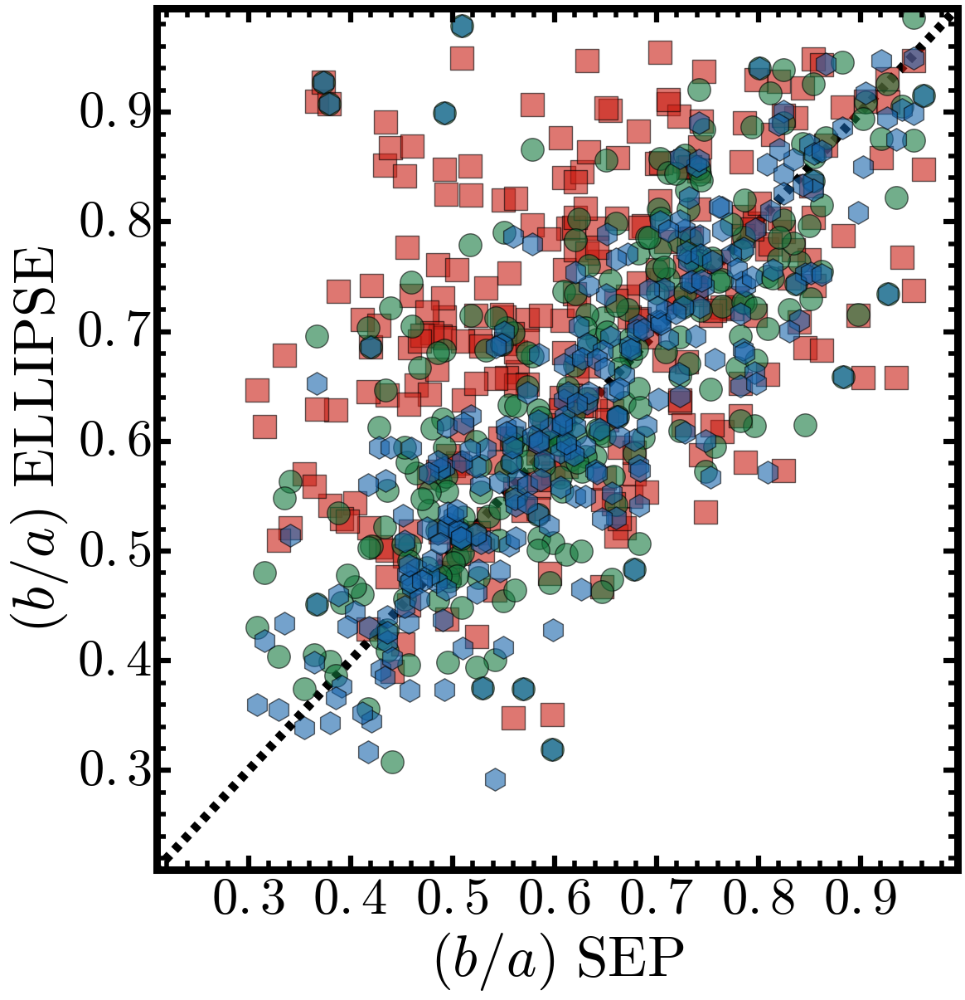

In [21]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['ba_aper'], cat['ba1_ellip'], s=390, c=ORG(0.8), alpha=0.6, marker='s')
ax1.scatter(cat['ba_aper'], cat['ba2_ellip'], s=390, c=GRN(0.8), alpha=0.6, marker='o')
ax1.scatter(cat['ba_aper'], cat['ba3_ellip'], s=390, c=BLU(0.8), alpha=0.6, marker='h')

ax1.plot(np.asarray([0.2, 1.0]), np.asarray([0.2, 1.0]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$(b/a)\ \mathrm{SEP}$', size=50)
ax1.set_ylabel('$(b/a)\ \mathrm{ELLIPSE}$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(0.21, 0.995)
ax1.set_ylim(0.21, 0.995)

fig.savefig('horizon_ba_compare_z0.37.pdf', dpi=90)

# Extract suface mass density profiles 

## Using Inner Shape

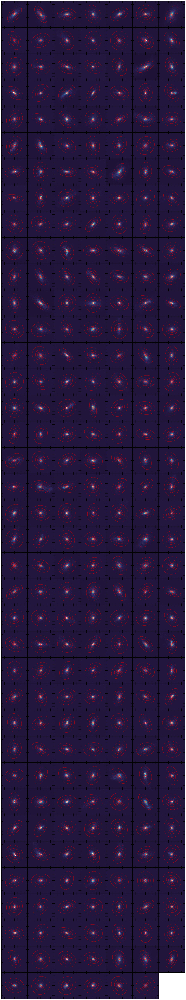

In [22]:
# Prepare the plot
fig = plt.figure(figsize=(14, 76))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(38, 7)
gs.update(wspace=0.0, hspace=0.00)

smaProf1, sbpProf1, cogProf1 = [], [], []

with ProgressBar(len(cat)) as bar:
    for item in enumerate(cat):
        ii, col = item
        galID = col['col1']
        bar.update()

        # Convert the mass density map to just mass maps
        # Convert the mass density map to just mass maps
        imgTest = os.path.join(imgDir, 'galaxy_{:03d}'.format(galID) + '.fits')
        
        imgN = fits.open(imgTest)[0].data
        imgN = imgN.byteswap().newbyteorder()
        
        try:
            baUse = col['ba1_ellip']
            paUse = hUtil.normAngle(col['pa1_ellip'], lower=-90, upper=90, b=True)
            ellOut, binOut = galSBP.galSBP(imgTest, galX=col['xCen_ellip'], galY=col['yCen_ellip'], 
                                           maxSma=220, iniSma=10.0, 
                                           verbose=False, savePng=False, saveOut=False,
                                           useZscale=False, expTime=1.0, pix=scale, zpPhoto=0.0,
                                           galQ=baUse, galPA=paUse, 
                                           stage=3, minSma=0.0, ellipStep=0.10,
                                           isophote=isophote, xttools=xttools, 
                                           fracBad=0.6, uppClip=6.0, lowClip=6.0, maxTry=9,
                                           nClip=0, intMode='median', updateIntens=False)
        except Exception:
            ellOut, binOut = None, None

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgN), np.std(imgN)
        im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')
        
        if ellOut is not None:
            # Estimate the average ellipticity and position angle 
            sma = ellOut['sma']
            kpc = sma * scale

            # Ellipticity and position angle profiles
            smaProf1.append(np.asarray(kpc))
            cogProf1.append(np.asarray(ellOut['growth_cor']))
            sbpProf1.append(np.asarray(ellOut['sbp']) / -2.5)

            # plot an ellipse for each object
            for i in range(len(objects)):
                for k, iso in enumerate(ellOut):
                    if k % 5 == 0:
                        e = Ellipse(xy=(iso['x0'], iso['y0']),
                                    height=iso['sma'] * 2.0,
                                    width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                    angle=iso['pa'])
                    e.set_facecolor('none')
                    e.set_edgecolor('r')
                    e.set_alpha(0.15)
                    ax.add_artist(e)
            ax.set_aspect('equal')
        else: 
            # Ellipticity and position angle profiles
            smaProf1.append(None)
            cogProf1.append(None)
            sbpProf1.append(None)
        
fig.savefig('horizon_map_ellip_step3_1_z0.37.pdf', dpi=120)

In [23]:
try:
    cat.remove_column('sma3a')
    cat.remove_column('sbp3a_prof')
    cat.remove_column('cog3a_prof')
except Exception:
    pass
cat.add_column(Column(smaProf1, name='sma3a'))
cat.add_column(Column(sbpProf1, name='sbp3a_prof'))
cat.add_column(Column(cogProf1, name='cog3a_prof'))

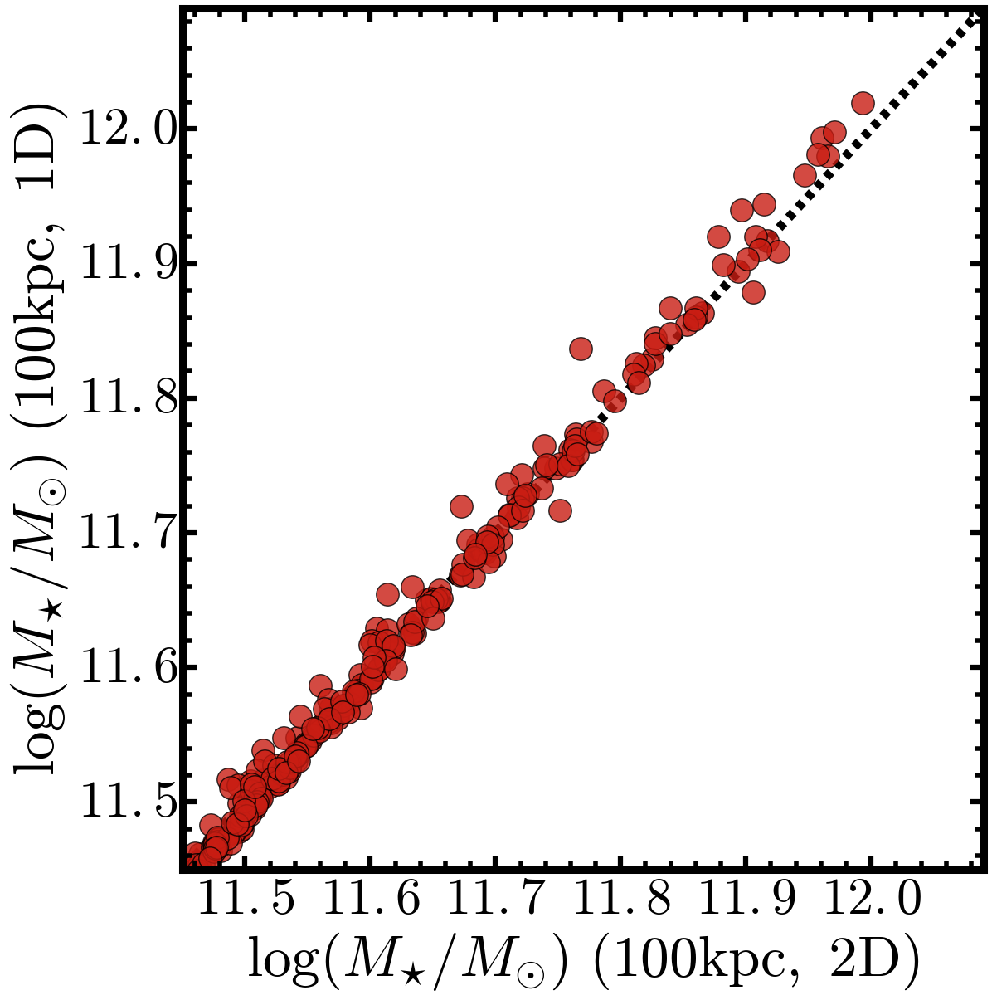

In [24]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

m100e = []
for gal in cat: 
    try:
        intrp = interp1d(gal['sma3a'], gal['cog3a_prof'])
        m100e.append(np.log10(intrp(100)) + 0.05)
    except Exception:
        m100e.append(None)
m100e = np.asarray(m100e)
    
ax1.scatter(cat['m100_aper'], m100e, s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{1D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.45, 12.09)
ax1.set_ylim(11.45, 12.09)

fig.savefig('horizon_m100_compare_ellip_inner_z0.37.pdf', dpi=90)

## Using Outer Shape

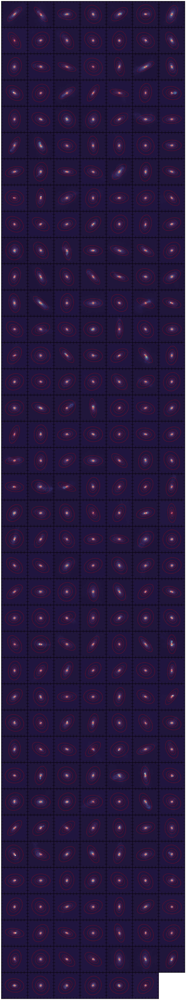

In [25]:
# Prepare the plot
fig = plt.figure(figsize=(14, 76))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)
gs = gridspec.GridSpec(38, 7)
gs.update(wspace=0.0, hspace=0.00)

smaProf2, sbpProf2, cogProf2 = [], [], []

with ProgressBar(len(cat)) as bar:
    for item in enumerate(cat):
        ii, col = item
        galID = col['col1']
        bar.update()

        # Convert the mass density map to just mass maps
        # Convert the mass density map to just mass maps
        imgTest = os.path.join(imgDir, 'galaxy_{:03d}'.format(galID) + '.fits')
        
        imgN = fits.open(imgTest)[0].data
        imgN = imgN.byteswap().newbyteorder()
        
        try:
            baUse = col['ba3_ellip']
            paUse = hUtil.normAngle(col['pa3_ellip'], lower=-90, upper=90, b=True)
            ellOut, binOut = galSBP.galSBP(imgTest, galX=col['xCen_ellip'], galY=col['yCen_ellip'], 
                                           maxSma=220, iniSma=10.0, 
                                           verbose=False, savePng=False, saveOut=False,
                                           useZscale=False, expTime=1.0, pix=scale, zpPhoto=0.0,
                                           galQ=baUse, galPA=paUse, 
                                           stage=3, minSma=0.0, ellipStep=0.10,
                                           isophote=isophote, xttools=xttools, 
                                           fracBad=0.6, uppClip=6.0, lowClip=6.0, maxTry=9,
                                           nClip=0, intMode='median', updateIntens=False)
        except Exception:
            ellOut, binOut = None, None

        # Show the aperture
        ax = plt.subplot(gs[ii])
        ax.yaxis.set_major_formatter(NullFormatter())
        ax.xaxis.set_major_formatter(NullFormatter())

        m, s = np.mean(imgN), np.std(imgN)
        im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                       vmin=m-1.5*s, vmax=m+10*s, origin='lower')
        
        if ellOut is not None:
            # Estimate the average ellipticity and position angle 
            sma = ellOut['sma']
            kpc = sma * scale

            # Ellipticity and position angle profiles
            smaProf2.append(np.asarray(kpc))
            cogProf2.append(np.asarray(ellOut['growth_cor']))
            sbpProf2.append(np.asarray(ellOut['sbp']) / -2.5)

            # plot an ellipse for each object
            for i in range(len(objects)):
                for k, iso in enumerate(ellOut):
                    if k % 5 == 0:
                        e = Ellipse(xy=(iso['x0'], iso['y0']),
                                    height=iso['sma'] * 2.0,
                                    width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                    angle=iso['pa'])
                    e.set_facecolor('none')
                    e.set_edgecolor('r')
                    e.set_alpha(0.15)
                    ax.add_artist(e)
            ax.set_aspect('equal')
        else: 
            # Ellipticity and position angle profiles
            smaProf2.append(None)
            cogProf2.append(None)
            sbpProf2.append(None)
        
fig.savefig('horizon_map_ellip_step3_2_z0.37.pdf', dpi=120)

In [26]:
#cat.remove_column('sma3b')
#cat.remove_column('sbp3b_prof')
#cat.remove_column('cog3b_prof')
cat.add_column(Column(smaProf2, name='sma3b'))
cat.add_column(Column(sbpProf2, name='sbp3b_prof'))
cat.add_column(Column(cogProf2, name='cog3b_prof'))

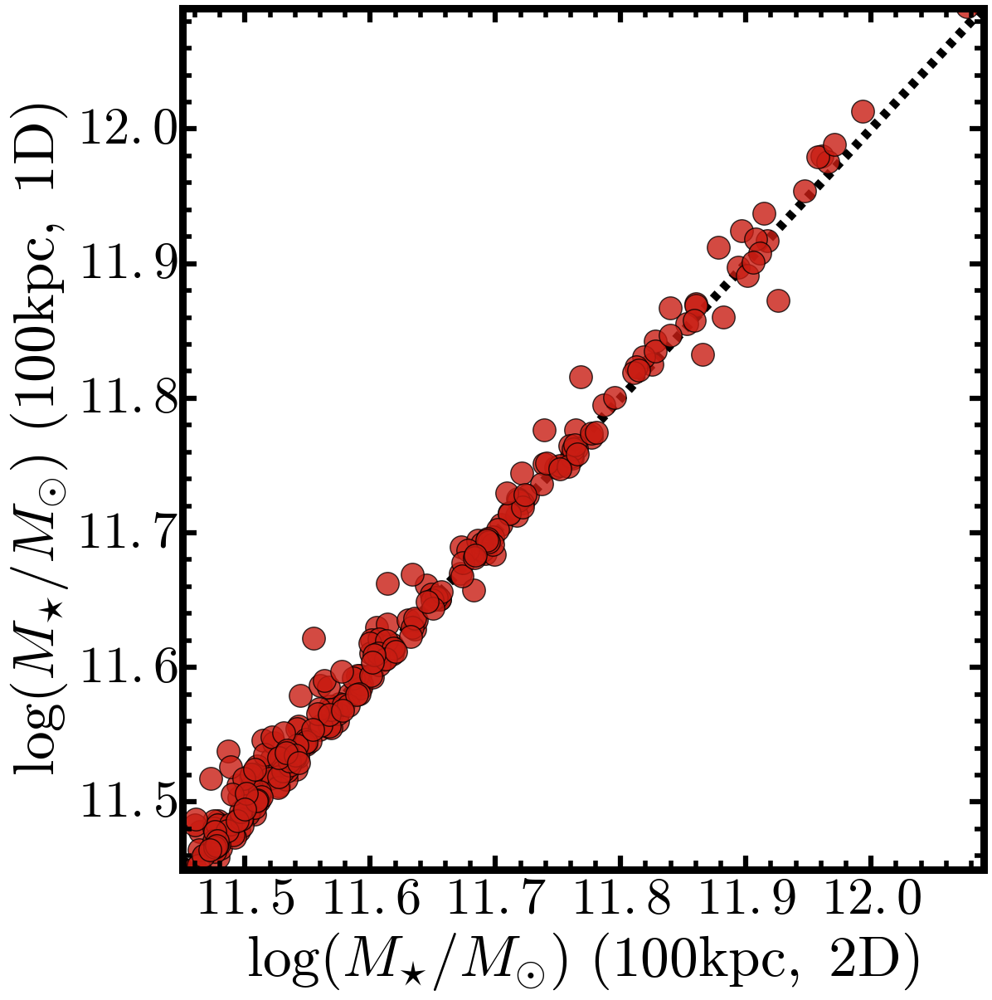

In [27]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

m100e = []
for gal in cat: 
    try:
        intrp = interp1d(gal['sma3b'], gal['cog3b_prof'])
        m100e.append(np.log10(intrp(100)) + 0.05)
    except Exception:
        m100e.append(None)
m100e = np.asarray(m100e)
    
ax1.scatter(cat['m100_aper'], m100e, s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{1D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.45, 12.09)
ax1.set_ylim(11.45, 12.09)

fig.savefig('horizon_m100_compare_ellip_z0.37.pdf', dpi=90)

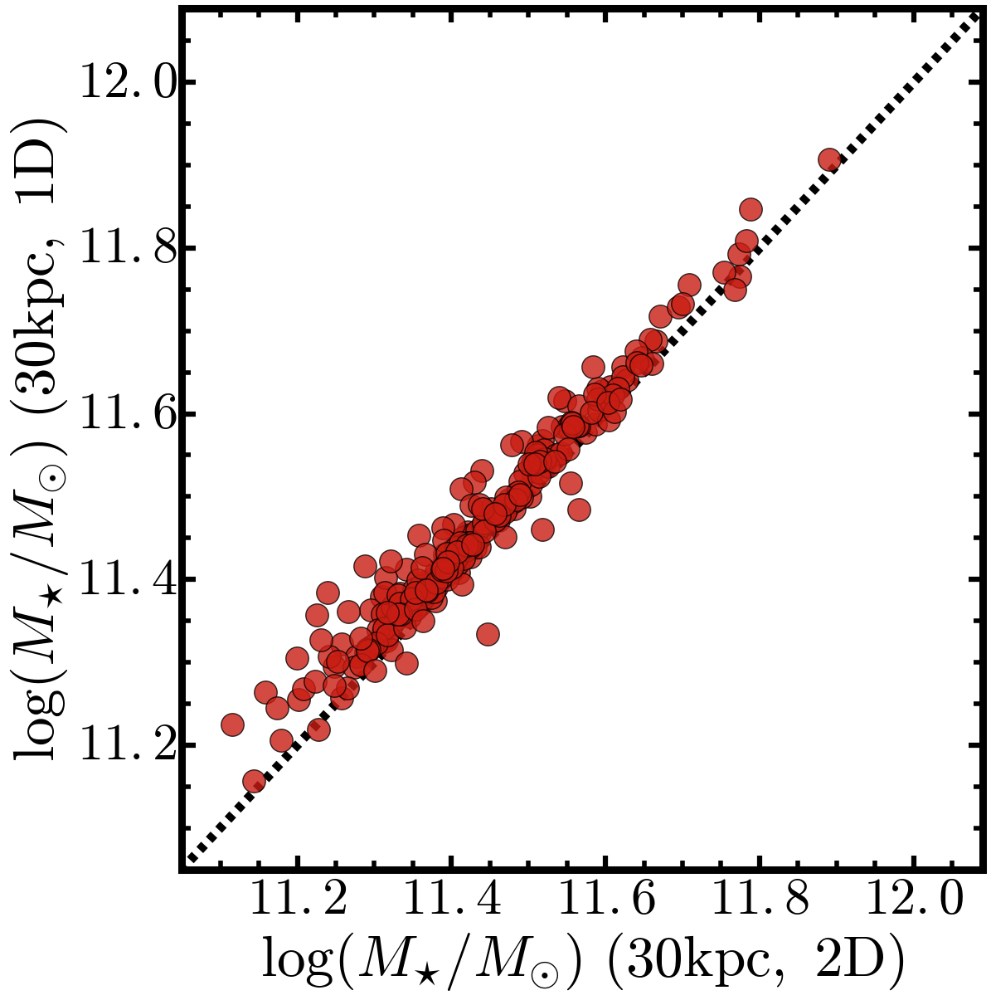

In [28]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

m30e = []
for gal in cat: 
    try:
        intrp = interp1d(gal['sma3b'], gal['cog3b_prof'])
        m30e.append(np.log10(intrp(30)) + 0.05)
    except Exception:
        m30e.append(None)
m30e = np.asarray(m30e)
    
ax1.scatter(cat['m30_aper'], m30e, s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([11.0, 12.2]), np.asarray([11.0, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (30 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (30 \mathrm{kpc},\ \mathrm{1D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.05, 12.09)
ax1.set_ylim(11.05, 12.09)

fig.savefig('horizon_m30_compare_ellip_z0.37.pdf', dpi=90)

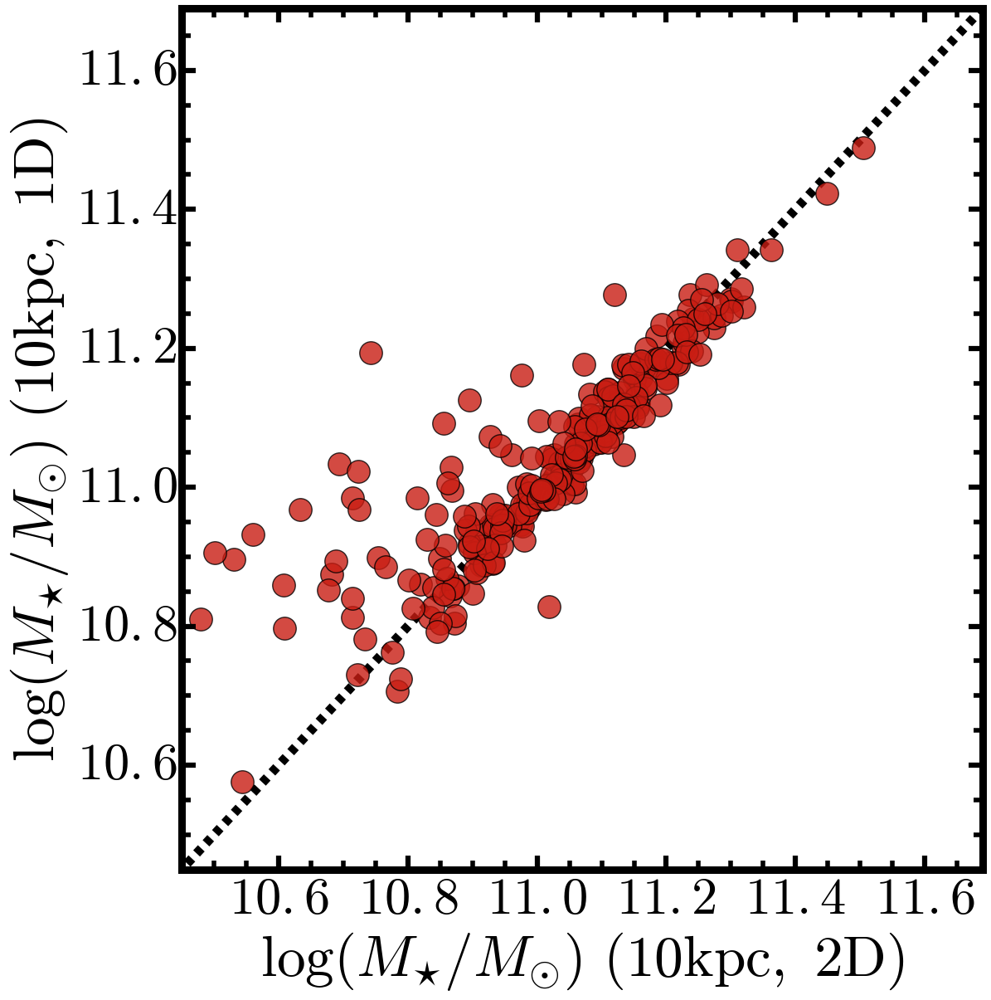

In [30]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

m10e = []
for gal in cat: 
    try:
        intrp = interp1d(gal['sma3b'], gal['cog3b_prof'])
        m10e.append(np.log10(intrp(10)))
    except Exception:
        m10e.append(None)
m10e = np.asarray(m10e)
    
ax1.scatter(cat['m10_aper'], m10e, s=390, c=ORG(0.8), alpha=0.8)

ax1.plot(np.asarray([10.4, 12.2]), np.asarray([10.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (10 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (10 \mathrm{kpc},\ \mathrm{1D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(10.45, 11.69)
ax1.set_ylim(10.45, 11.69)

fig.savefig('horizon_m10_compare_ellip_z0.37.pdf', dpi=90)

# Compare with HSC

In [33]:
# Location of the data
homeDir = os.getenv('HOME')
sbpDir = os.path.join(homeDir, 'astro4/massive/dr15b/sbp/')

# Location for figures
figDir = os.path.join(sbpDir, 'figure')
# Location for subsamples
sampleDir = os.path.join(sbpDir, 'catalog')

masterDir = os.path.join(homeDir, 'astro4/massive/dr15b/master')

# The SED models 
# 'fsps1', 'fsps2', 'fsps3', 'fsps4', 'bc03a'
sedMod = 'fsps1'
# 'imgsub', 'img'
sbpType = 'imgsub'

# Catalog files for BCG and NonBCG
redbcgStr = 'dr1_redbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
nonbcgStr = 'dr1_nonbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
redmemStr = 'dr1_redmem_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'

redbcgFile = redbcgStr + '.fits' 
nonbcgFile = nonbcgStr + '.fits' 
redmemFile = redmemStr + '.fits'

# Output
redbcgPrep = redbcgFile.replace('.fits', '_prep.fits')
nonbcgPrep = nonbcgFile.replace('.fits', '_prep.fits')
redmemPrep = redmemFile.replace('.fits', '_prep.fits')

redbcgLab1 = '$\mathrm{cenLowMh}$'
redbcgLab2 = '$\mathrm{cenHighMh}$'
nonbcgLab = '$\mathrm{cenLowMh}$'

try:
    redbcgTab
except NameError:
    pass
else:
    del redbcgTab     
try:
    nonbcgTab
except NameError:
    pass
else:
    del nonbcgTab
    
# Location for the SBP summary file
redbcgDir = os.path.join(sbpDir, 'redbcg')
nonbcgDir = os.path.join(sbpDir, 'nonbcg')
redmemDir = os.path.join(sbpDir, 'redmem')

# Two summary catalogs
redbcgCat = os.path.join(sampleDir, redbcgFile)
nonbcgCat = os.path.join(sampleDir, nonbcgFile)
redmemCat = os.path.join(sampleDir, redmemFile)

prefix1 = 'redbcg'
prefix2 = 'nonbcg'
prefix3 = 'redmem'

In [34]:
# The CLEAN sample: 
redbcgClean = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
nonbcgClean = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
redmemClean = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_clean.fits')), 
                         format='fits')

# The USE samples: 
redbcgUse = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
nonbcgUse = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
redmemUse = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_use.fits')), 
                         format='fits')

# The GAMA sample
redbcgGama = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')
nonbcgGama = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')

redbcgGamaZ = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')
nonbcgGamaZ = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')

# Stripe 82 
s82data = Table.read(os.path.join(masterDir, 'dr1_s82_clean_zbin_isedfit_fsps2.fits'), 
                     format='fits')

In [35]:
def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None

redbcgProfMbin0 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin0_profs.pkl'))
redbcgProfMbin1 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin1_profs.pkl'))
redbcgProfMbin2 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin2_profs.pkl'))
redbcgProfMbin3 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin3_profs.pkl'))
nonbcgProfMbin0 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin0_profs.pkl'))
nonbcgProfMbin1 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin1_profs.pkl'))
nonbcgProfMbin2 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin2_profs.pkl'))

In [36]:
aa = Table([redbcgClean['z_use'], redbcgClean['logm_100'], redbcgClean['MSTAR'], redbcgClean['logm_10']])
bb = Table([nonbcgClean['z_use'], nonbcgClean['logm_100'], nonbcgClean['MSTAR'], nonbcgClean['logm_10']])
#cc = Table([redmemClean['z_use'], redmemClean['logm_100'], redmemClean['MSTAR'], redmemClean['logm_150']])

from astropy.table import vstack
massAll = vstack([aa, bb])

sampleM100c = 'matchA_m100_' + sedMod
redbcgProfM100c = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100c + '_profs.pkl'))
nonbcgProfM100c = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100c + '_profs.pkl'))

In [37]:
print(np.nanmedian(massAll[(massAll['logm_100'] >= 11.4) & (massAll['logm_100'] < 11.6)]['logm_100']), 
      np.nanmedian(massAll[(massAll['logm_100'] >= 11.6) & (massAll['logm_100'] < 11.8)]['logm_100']),
      np.nanmedian(massAll[(massAll['logm_100'] >= 11.8) & (massAll['logm_100'] < 12.0)]['logm_100']))

11.4878570681 11.6629385046 11.8672917344


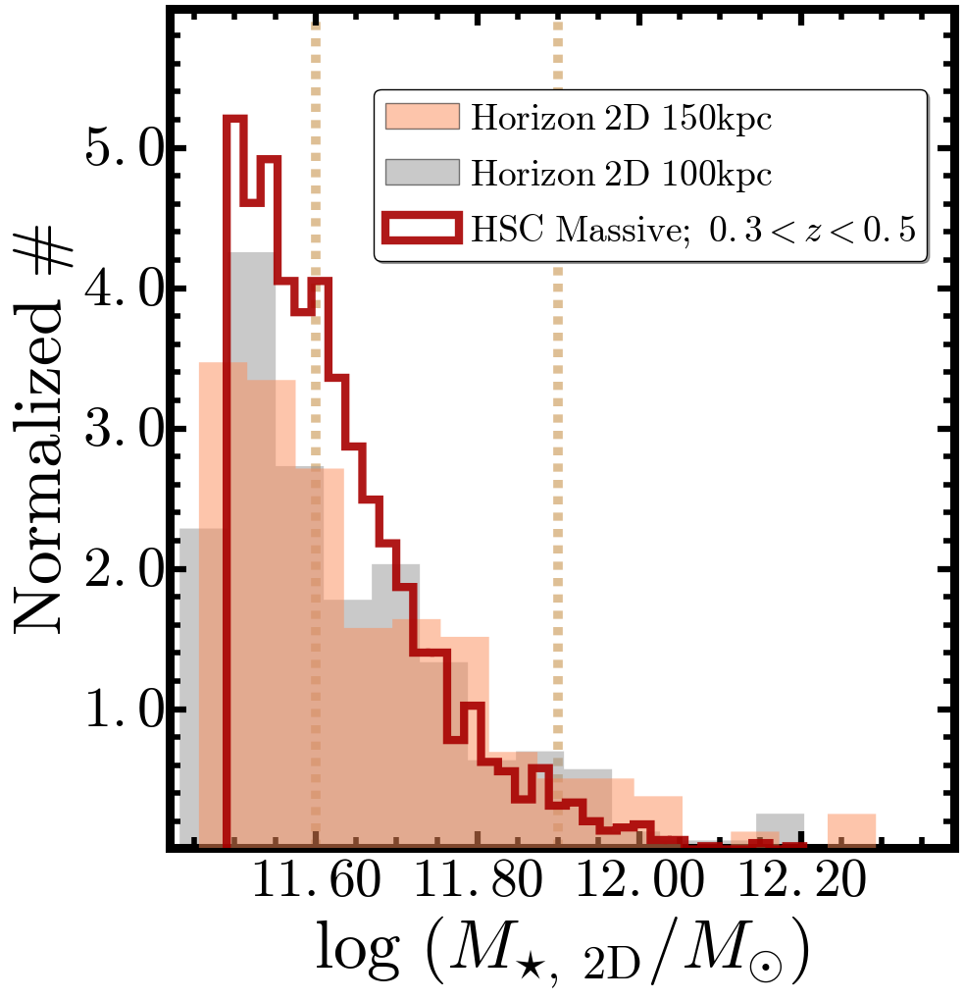

In [40]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.2f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin2 = nonbcgUse[(nonbcgUse['z_use'] >= 0.20)] 
redbcgBin2 = redbcgUse[(redbcgUse['z_use'] >= 0.20)] 

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

massHigh = massAll[(massAll['logm_100'] >= 11.49)]

temp = hist(cat['m150_aper'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3, rasterized=True,
            label='$\mathrm{Horizon\; 2D\ 150\mathrm{kpc}}$')
temp = hist(cat['m100_aper'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{Horizon\; 2D\ 100\mathrm{kpc}}$')

temp = hist(massHigh['logm_100'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{HSC\ Massive};\ 0.3 < z < 0.5$')
#temp = hist(nonbcgBin['logm_100'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=BLK(0.9), linewidth=6.0,
#            normed=True, ax=ax1, zorder=6, rasterized=True,
#            label='$\mathrm{cenLowMh};\ 0.3 < z < 0.5$')

ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)

ax1.set_xlim(11.42, 12.39)
ax1.set_ylim(0.01, 5.99)

ax1.set_xlabel('$\log\ ({M_{\star,\ 2\mathrm{D}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.26, 0.70), shadow=True, fancybox=True, 
           numpoints=1, fontsize=27, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.3)
legend = ax1.get_legend()

fig.savefig('horizon_logm100_hist_z0.37.pdf', dpi=110)

plt.show()

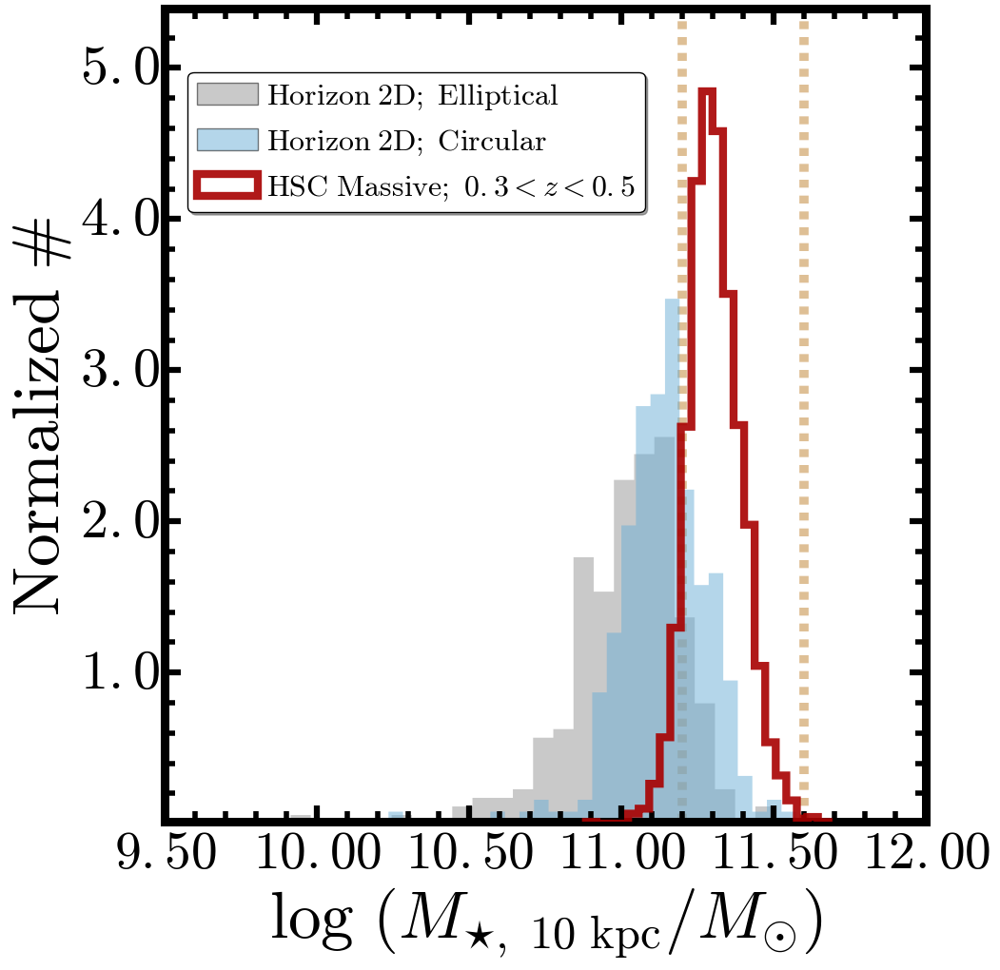

In [42]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.2f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin2 = nonbcgUse[(nonbcgUse['z_use'] >= 0.20)] 
redbcgBin2 = redbcgUse[(redbcgUse['z_use'] >= 0.20)] 

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

massHigh = massAll[(massAll['logm_100'] >= 11.45)]

temp = hist(cat['m10_aper'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{Horizon\; 2D;\ Elliptical}$')
temp = hist(cat['m10c_aper'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLU(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{Horizon\; 2D;\ Circular}$')

temp = hist(massHigh['logm_10'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{HSC\ Massive};\ 0.3 < z < 0.5$')

ax1.axvline(11.20, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)

#ax1.set_xlim(10., 12.39)
ax1.set_ylim(0.01, 5.39)

ax1.set_xlabel('$\log\ ({M_{\star,\ 10\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.03, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=23, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.3)
legend = ax1.get_legend()

fig.savefig('horizon_logm10_hist_z0.37.pdf', dpi=150)

plt.show()

In [56]:
def organizeSbp(profiles, col1='muI1', col2='KCORRECT_I', 
                kind='sbp', norm=False, r1=9.9, r2=10.1, divide=False,
                col3=None, col4=None, justStack=False, integrate=False,
                sun1=SUN_G, sun2=SUN_R, normArr=None,
                index=None, extCat=None, rCol=None, 
                rNorm=False, rNormCol='R50_100', 
                rCommon=RR50_COMMON):
    """ Get the stack of individual profiels, and their med/avg. """
    if rCol is None: 
        rCol = 'rKpc'
        
    if rNorm is True:
        print("!!!! Normalize the radius using R50")
        rarr = np.vstack((p[rCol] / p.meta[rNormCol]) for p in profiles)
    else:
        rarr = np.vstack(p[rCol] for p in profiles)
     
    # Surface brightness profile / luminosity profiles
    if kind.strip() == 'sbp':
        if col2 is not None: 
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(p[col1] + (p.meta[col2] / 2.5)), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1] + (p.meta[col2] / 2.5)) 
                                  for p in profiles)
        else: 
            print("## NO KCORRECTION APPLIED !!")            
            if norm:
                stack = np.vstack(normProf(p[rCol], p[col1], 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
    # Mass profiles
    elif kind.strip() == 'mass':
        if norm and (normArr is None):
            stack = np.vstack(normProf(p[rCol], 
                                       np.asarray(p[col1] + p.meta[col2]), 
                                       r1, r2, divide=divide, integrate=integrate) 
                              for p in profiles)
        elif norm and (normArr is not None):
            stack = np.vstack((np.asarray(p[col1] + p.meta[col2]) - normArr[i]) for (i, p) 
                              in enumerate(profiles))
        else: 
            stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
    # Color profiles
    elif kind.strip() == 'color':
        cSun = (sun1 - sun2)
        if col3 is None or col4 is None:
            print("## NO KCORRECTION APPLIED !!")
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 *(p[col1] - p[col2])) for p in profiles)
        else:
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                                      (p.meta[col3] - p.meta[col4])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                             (p.meta[col3] - p.meta[col4])) 
                                  for p in profiles)
    # Luminosity or stellar mass curve of growth
    elif kind.strip() == 'cog':
        if col2 is None:
            # Luminosity
            if not norm:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] - p.meta[col3]) for p in profiles)
        else: 
            # Stellar mass
            if not norm:
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2] 
                                             - p.meta[col3]) for p in profiles)
    else: 
        raise Exception("## WRONG KIND !!")
        
    if index is not None: 
        stack = np.vstack(p[index] for p in stack)
        rarr = np.vstack(r[index] for r in rarr)
    
    if rNorm is True: 
        print("!!!! Interpoate the profiles to new oommon radius")
        interps = map(lambda r, p: interp1d(r, p, kind='slinear', bounds_error=False), 
                      rarr, stack)
        stack = np.vstack(intrp(rCommon) for intrp in interps)
        
    if not justStack:
        """ Get the median and 1-sigma confidence range """
        try:
            stdProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanstd, numResamples=1500, 
                                          interpolate=True) 
        except Exception:
            print("!!! Boostramp resample fails for standard deviation !!!")
            std1 = np.nanstd(stack, axis=0)
            stdProf = [std1, std1, std1, std1]
            
        try:
            medProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanmedian, numResamples=1500, 
                                          interpolate=True) 
        except Exception: 
            print("!!! Boostramp resample fails for median !!!")
            medProf = np.nanmedian(stack, axis=0)
            medProf = [medProf - np.nanstd(stack, axis=0), medProf, medProf,
                       medProf + np.nanstd(stack)]
            
        try: 
            avgProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanmean, numResamples=1500, 
                                          interpolate=False) 
        except Exception: 
            print("!!! Boostramp resample fails for mean !!!")
            avgProf = np.nanmean(stack, axis=0)
            avgProf = [avgProf - np.nanstd(stack, axis=0), avgProf, avgProf,
                       avgProf + np.nanstd(stack)]
        
        return stack, medProf, avgProf, stdProf
    else: 
        return stack

In [60]:
# Combined the redbcg and nonbcg samples
galProfMbin0 = redbcgProfMbin0 + nonbcgProfMbin0
galProfMbin1 = redbcgProfMbin1 + nonbcgProfMbin1
galProfMbin2 = redbcgProfMbin2 + nonbcgProfMbin2

# Get the average profiles
rm0_sl, rm0_ml, rm0_aml, rm0_stdl = organizeSbp(galProfMbin0, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm1_sl, rm1_ml, rm1_aml, rm1_stdl = organizeSbp(galProfMbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm2_sl, rm2_ml, rm2_aml, rm2_stdl = organizeSbp(galProfMbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

## Save the HSC average profiles into pickle files 

In [31]:
hscAvgProf0 = {'sma':RSMA_COMMON, 'all':rm0_sl, 'med':rm0_ml, 
               'avg':rm0_aml}
hscAvgProf1 = {'sma':RSMA_COMMON, 'all':rm1_sl, 'med':rm1_ml, 
               'avg':rm1_aml}
hscAvgProf2 = {'sma':RSMA_COMMON, 'all':rm2_sl, 'med':rm2_ml, 
               'avg':rm2_aml}

pickle.dump(hscAvgProf0, open("hscAvgProf0.pkl", "wb"))
pickle.dump(hscAvgProf1, open("hscAvgProf1.pkl", "wb"))
pickle.dump(hscAvgProf2, open("hscAvgProf2.pkl", "wb"))

In [43]:
hscAvgProf0 = loadPkl("hscAvgProf0.pkl")
hscAvgProf1 = loadPkl("hscAvgProf1.pkl")
hscAvgProf2 = loadPkl("hscAvgProf2.pkl")

rm0_sl, rm0_ml, rm0_aml = hscAvgProf0['all'], hscAvgProf0['med'], hscAvgProf0['avg']
rm1_sl, rm1_ml, rm1_aml = hscAvgProf1['all'], hscAvgProf1['med'], hscAvgProf1['avg']
rm2_sl, rm2_ml, rm2_aml = hscAvgProf2['all'], hscAvgProf2['med'], hscAvgProf2['avg']

## Organize the Horizon profiles

In [45]:
print(cat.colnames)

['col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'xCen_aper', 'yCen_aper', 'ba_aper', 'pa_aper', 'm10_aper', 'm30_aper', 'm100_aper', 'm150_aper', 'm200_aper', 'r50_aper', 'sbp_aper', 'mass_aper', 'r50_prof', 'm10c_aper', 'm30c_aper', 'm100c_aper', 'm150c_aper', 'm200c_aper', 'xCen_ellip', 'yCen_ellip', 'ba1_ellip', 'pa1_ellip', 'ba2_ellip', 'pa2_ellip', 'ba3_ellip', 'pa3_ellip', 'sma2', 'ell_prof', 'pa_prof', 'sbp2_prof', 'sma3a', 'sbp3a_prof', 'cog3a_prof', 'sma3b', 'sbp3b_prof', 'cog3b_prof']


In [46]:
pickle.dump(cat, open('horizon_z0.37_profile.pkl', "wb"))

In [100]:
cat = loadPkl('horizon_z0.37_profile.pkl')

In [90]:
bMass0A = cat[(cat['m150_aper'] >= 11.35) &
              (cat['m150_aper'] < 11.55)]
bMass1A = cat[(cat['m150_aper'] >= 11.55) &
              (cat['m150_aper'] < 11.75)]
bMass2A = cat[(cat['m150_aper'] >= 11.75) &
              (cat['m150_aper'] < 11.95)]

bMass0B = cat[(cat['m100_aper'] >= 11.40) &
              (cat['m100_aper'] < 11.60)]
bMass1B = cat[(cat['m100_aper'] >= 11.55) &
              (cat['m100_aper'] < 11.75)]
bMass2B = cat[(cat['m100_aper'] >= 11.75) &
              (cat['m100_aper'] < 11.95)]

print(len(bMass0A), len(bMass1A), len(bMass2A))
print(len(bMass0B), len(bMass1B), len(bMass2B))

89 113 45
136 108 43


In [91]:
print(np.nanmedian(bMass0A['m150_aper']),
      np.nanmedian(bMass1A['m150_aper']),
      np.nanmedian(bMass2A['m150_aper']))

print(np.nanmedian(bMass0B['m100_aper']),
      np.nanmedian(bMass1B['m100_aper']),
      np.nanmedian(bMass2B['m100_aper']))

11.5072369292 11.6322332189 11.8061758423
11.5138065291 11.6251691088 11.8252259977


In [92]:
RSMA_SIM = np.arange(0.4, 3.8, 0.05)

bMProf0A = []
for obj in bMass0A:
    intrp = interp1d(obj['sma3a'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf0A.append(prof)
bMProf0A = np.asarray(bMProf0A)

bAvgProf0A = confidence_interval(bMProf0A, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf0B = []
for obj in bMass0B:
    intrp = interp1d(obj['sma3a'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf0B.append(prof)
bMProf0B = np.asarray(bMProf0B)

bAvgProf0B = confidence_interval(bMProf0B, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf1A = []
for obj in bMass1A:
    intrp = interp1d(obj['sma3a'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf1A.append(prof)
bMProf1A = np.asarray(bMProf1A)

bAvgProf1A = confidence_interval(bMProf1A, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf1B = []
for obj in bMass1B:
    intrp = interp1d(obj['sma3a'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf1B.append(prof)
bMProf1B = np.asarray(bMProf1B)

bAvgProf1B = confidence_interval(bMProf1B, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf2A = []
for obj in bMass2A:
    intrp = interp1d(obj['sma3a'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf2A.append(prof)
bMProf2A = np.asarray(bMProf2A)

bAvgProf2A = confidence_interval(bMProf2A, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf2B = []
for obj in bMass2B:
    intrp = interp1d(obj['sma3a'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf2B.append(prof)
bMProf2B = np.asarray(bMProf2B)

bAvgProf2B = confidence_interval(bMProf2B, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

In [93]:
bMProf0C = []
for obj in bMass0A:
    intrp = interp1d(obj['sma3b'], obj['sbp3b_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf0C.append(prof)
bMProf0C = np.asarray(bMProf0C)

bAvgProf0C = confidence_interval(bMProf0C, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf0D = []
for obj in bMass0B:
    intrp = interp1d(obj['sma3b'], obj['sbp3b_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf0D.append(prof)
bMProf0D = np.asarray(bMProf0D)

bAvgProf0D = confidence_interval(bMProf0D, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf1C = []
for obj in bMass1A:
    intrp = interp1d(obj['sma3b'], obj['sbp3b_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf1C.append(prof)
bMProf1C = np.asarray(bMProf1C)

bAvgProf1C = confidence_interval(bMProf1C, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf1D = []
for obj in bMass1B:
    intrp = interp1d(obj['sma3b'], obj['sbp3b_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf1D.append(prof)
bMProf1D = np.asarray(bMProf1D)

bAvgProf1D = confidence_interval(bMProf1D, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf2C = []
for obj in bMass2A:
    intrp = interp1d(obj['sma3b'], obj['sbp3b_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf2C.append(prof)
bMProf2C = np.asarray(bMProf2C)

bAvgProf2C = confidence_interval(bMProf2C, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf2D = []
for obj in bMass2B:
    intrp = interp1d(obj['sma3b'], obj['sbp3b_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf2D.append(prof)
bMProf2D = np.asarray(bMProf2D)

bAvgProf2D = confidence_interval(bMProf2D, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

In [94]:
bCProf1B = []
for obj in bMass1B:
    intrp = interp1d(obj['sma3b'], np.log10(obj['cog3b_prof']))
    cprof = intrp(RSMA_SIM ** 4.0)
    bCProf1B.append(cprof)
bCProf1B = np.asarray(bCProf1B)

bAvgCProf1B = np.nanmean(bCProf1B, axis=0)

bCProf2B = []
for obj in bMass2B:
    intrp = interp1d(obj['sma3b'], np.log10(obj['cog3b_prof']))
    cprof = intrp(RSMA_SIM ** 4.0)
    bCProf2B.append(cprof)
bCProf2B = np.asarray(bCProf2B)

bAvgCProf2B = np.nanmean(bCProf2B, axis=0)

/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:3: RuntimeWarning: divide by zero encountered in log10
  app.launch_new_instance()
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:12: RuntimeWarning: divide by zero encountered in log10


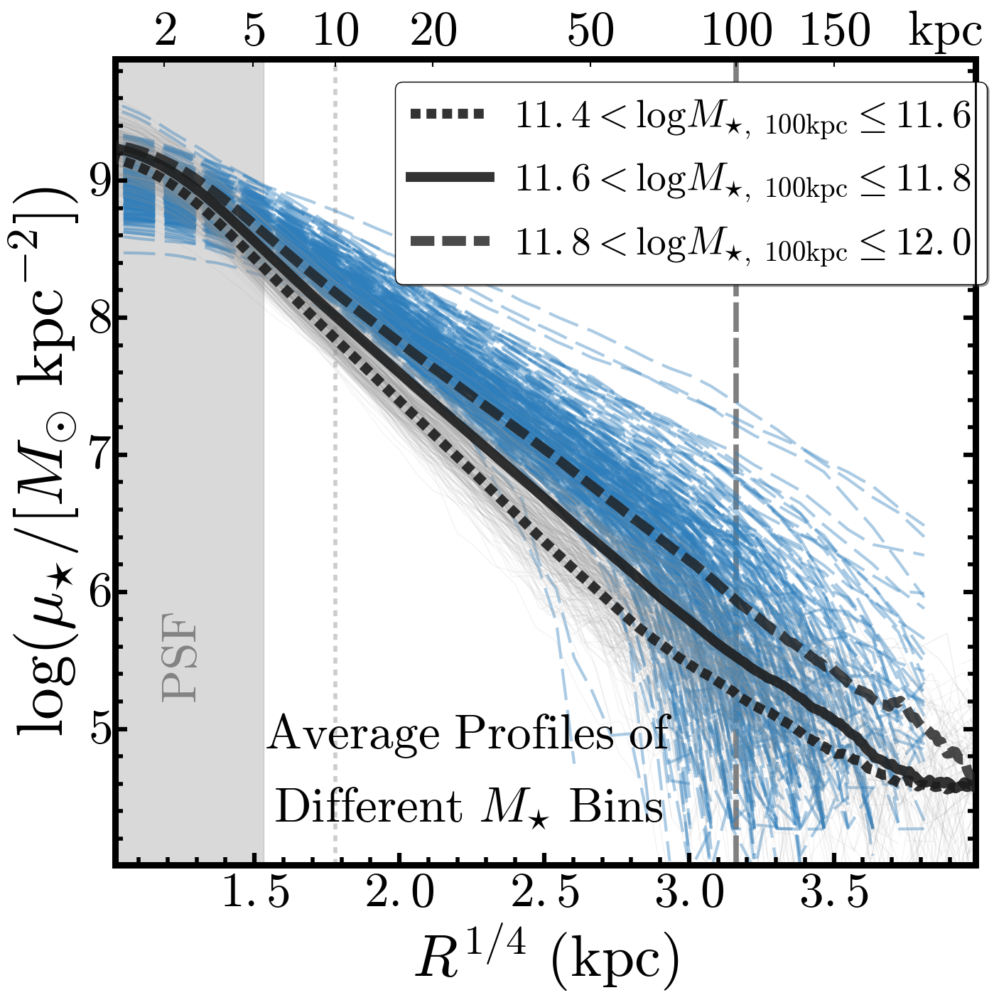

In [53]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$11.4 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.6$"
label2="$11.6 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.8$"
label3="$11.8 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 12.0$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.13, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm0_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, aa, c=color1a, alpha=0.10, linewidth=1.1)
for ii, bb in enumerate(rm1_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, bb, c=color1a, alpha=0.15, linewidth=1.1)
for ii, cc in enumerate(rm2_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, cc, c=color1a, alpha=0.15, linewidth=1.1)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax1.plot(RSMA_COMMON, rm0_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1, dashes=(10,6))

ax1.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label2)

ax1.plot(RSMA_COMMON, rm2_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=label3, dashes=(24,8))

# ========= #
for gal in cat:
    try:
        ax1.plot(gal['sma3a'] ** 0.25, gal['sbp3a_prof']-0.16, linestyle='--', linewidth=3.0, 
                 c=BLU(0.7), alpha=0.4, zorder=0, dashes=(32,10))
    except Exception:
        pass
# ========= #

# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=65)
    
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(0.325, 0.72), shadow=True, fancybox=True, 
               numpoints=1, fontsize=40, scatterpoints=1, 
               markerscale=1.2, borderpad=0.4, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(xmin, xmax)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax2.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax2.transAxes)
# --------------------------------------------------------------------------------------- #
ax1.text(0.41, 0.13, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
ax1.text(0.41, 0.04, '$\mathrm{Different\ }M_{\star}\ \mathrm{Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #

vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

fig.savefig('horizon_average_mass_profiles_ellipse1_z0.37.pdf', dpi=110)

plt.show()

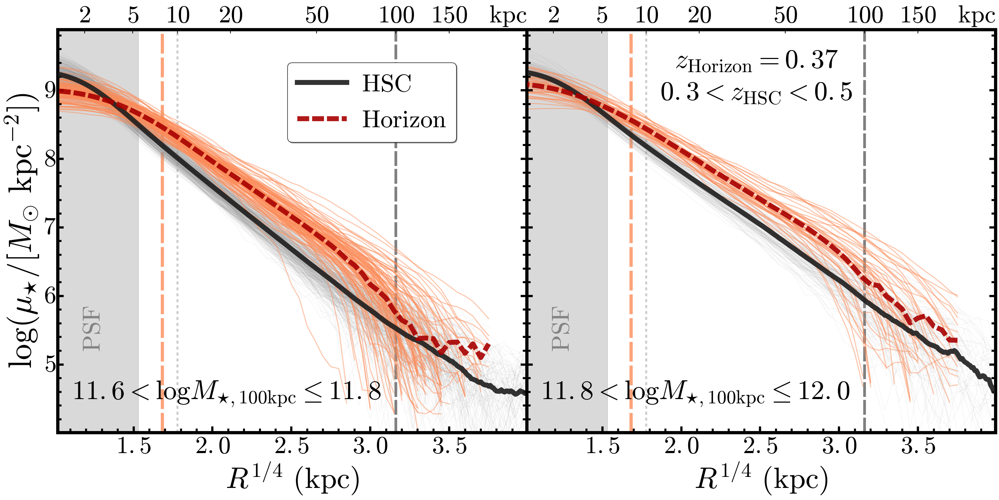

In [95]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$\mathrm{HSC}$"
label2="$\mathrm{Horizon}$"

label3="$11.4 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.6$"
label4="$11.6 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.8$"
label5="$11.8 < \log{M_{\star, 100\mathrm{kpc}}} \leq 12.0$"

label6="$0.3 < z_{\mathrm{HSC}} < 0.5$"
label7="$z_{\mathrm{Horizon}}=0.37$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(28.5, 14))
fig.subplots_adjust(left=0.07, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
ax3 = fig.add_subplot(121)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax3.axvline(8.0 ** 0.25, linewidth=6.5, c=ORG(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm1_sl):
    if (ii % 2) == 0:
        ax3.plot(RSMA_COMMON, aa, c=color1a, alpha=0.10, linewidth=1.1)
        
for ii, aa in enumerate(bMProf1B):
    ax3.plot(RSMA_SIM, aa-0.15, c=color2a, alpha=0.50, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax3.plot(RSMA_SIM, bAvgProf1B[2]-0.15, linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
ax3.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=65)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax3.legend(loc=(0.49, 0.720), shadow=True, fancybox=True, 
           numpoints=1, fontsize=50, scatterpoints=1, 
           markerscale=1.2, borderpad=0.4, handletextpad=0.6)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax4.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.36, 0.06, label4,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
ax5 = fig.add_subplot(122)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax5.axvline(8.0 ** 0.25, linewidth=6.5, c=ORG(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)
    
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm2_sl):
    ax5.plot(RSMA_COMMON, aa, c=color1a, alpha=0.10, linewidth=1.1)
        
for ii, aa in enumerate(bMProf2B):
    ax5.plot(RSMA_SIM, aa-0.15, c=color2a, alpha=0.50, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.plot(RSMA_COMMON, rm2_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label3)

ax5.plot(RSMA_SIM, bAvgProf2B[2]-0.15, linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, label=label6, dashes=(24,6))

# --------------------------------------------------------------------------------------- #
## Y Lables
ax5.yaxis.set_major_formatter(NullFormatter())
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.49, 0.89, label7,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
ax5.text(0.49, 0.81, label6,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.36, 0.06, label5,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join('horizon_mass_prof_1B.pdf'), dpi=120)

plt.show()

## Plot the mass curve of growth

In [66]:
# --------------------------------------------------------------------------------------- #
indCoG1, indCoG2 = 0.8, 3.5
RSMA_COG = RSMA_COMMON[(RSMA_COMMON >= indCoG1) & 
                       (RSMA_COMMON <= indCoG2)]
indCoG = np.intersect1d(np.where(RSMA_COMMON >= indCoG1)[0], 
                        np.where(RSMA_COMMON <= indCoG2)[0])
## Stellar mass curve of growth
cogS1a, cogM1a, cogA1a, cogD1a = organizeSbp(galProfMbin1, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False, 
                                             index=indCoG) 
cogS2a, cogM2a, cogA2a, cogD2a = organizeSbp(galProfMbin2, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False,
                                             index=indCoG) 
## Normalized fraction
cogS1b, cogM1b, cogA1b, cogD1b = organizeSbp(galProfMbin1, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100', 
                                             index=indCoG) 
cogS2b, cogM2b, cogA2b, cogD2b = organizeSbp(galProfMbin2, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100',
                                             index=indCoG) 
# --------------------------------------------------------------------------------------- #

!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!


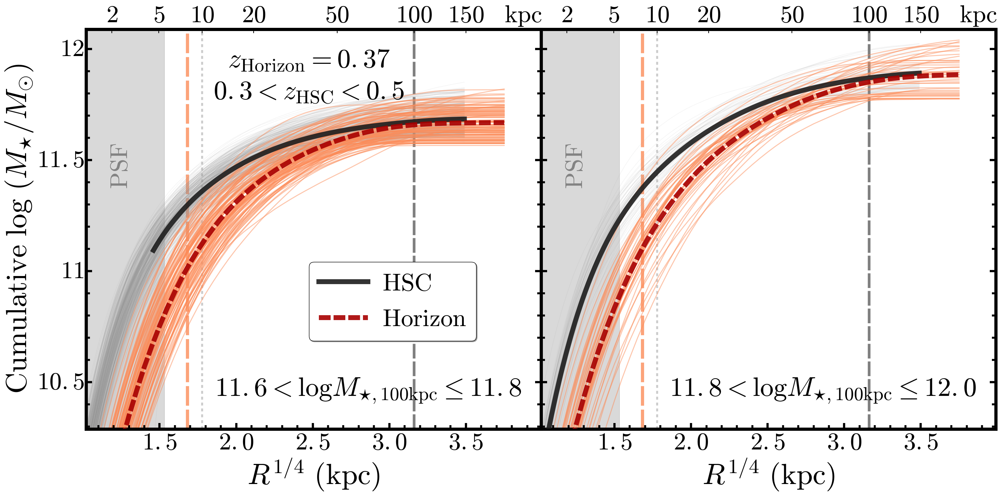

In [101]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 10.29, 12.09
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$\mathrm{HSC}$"
label2="$\mathrm{Horizon}$"

label3="$11.4 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.6$"
label4="$11.6 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.8$"
label5="$11.8 < \log{M_{\star, 100\mathrm{kpc}}} \leq 12.0$"

label6="$0.3 < z_{\mathrm{HSC}} < 0.5$"
label7="$z_{\mathrm{Horizon}}=0.37$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(28.5, 14))
fig.subplots_adjust(left=0.09, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
ax3 = fig.add_subplot(121)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax3.axvline(8.0 ** 0.25, linewidth=6.5, c=ORG(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(cogS1a):
    if (ii % 2) == 0:
        ax3.plot(RSMA_COG, aa, c=color1a, alpha=0.10, linewidth=1.1)
        
for ii, aa in enumerate(bCProf1B):
    ax3.plot(RSMA_SIM, aa+0.07, c=color2a, alpha=0.50, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COG, cogA1a[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax3.plot(RSMA_SIM, bAvgCProf1B+0.07, linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
ax3.set_ylabel('$\mathrm{Cumulative\ }\log\ (M_{\star}/M_{\odot})$', size=60)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.60, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax3.legend(loc=(0.49, 0.220), shadow=True, fancybox=True, 
           numpoints=1, fontsize=50, scatterpoints=1, 
           markerscale=1.2, borderpad=0.4, handletextpad=0.6)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax4.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.62, 0.06, label4,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
ax5 = fig.add_subplot(122)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax5.axvline(8.0 ** 0.25, linewidth=6.5, c=ORG(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(cogS2a):
    if (ii % 2) == 0:
        ax5.plot(RSMA_COG, aa, c=color1a, alpha=0.10, linewidth=1.1)
        
for ii, aa in enumerate(bCProf2B):
    ax5.plot(RSMA_SIM, aa+0.07, c=color2a, alpha=0.50, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.plot(RSMA_COG, cogA2a[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax5.plot(RSMA_SIM, bAvgCProf2B+0.07, linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)
    
# --------------------------------------------------------------------------------------- #
## Y Lables
ax5.yaxis.set_major_formatter(NullFormatter())
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.60, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.49, 0.89, label7,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
ax3.text(0.49, 0.81, label6,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)

# --------------------------------------------------------------------------------------- #
ax5.text(0.62, 0.06, label5,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join('horizon_mass_cog_1B.pdf'), dpi=120)

plt.show()

## Compare the ellipticity profile

In [57]:
profSample1, profSample2 = nonbcgProfM100c, redbcgProfM100c
outPng = sampleM100c
figDir = figDir
save = True
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.15
ymin1, ymax1 = 0.02, 0.69
norm, integrate, normR1 = False, False, 10.0
rsma0 = 1.02
rsma1 = 3.45
#-------------------------------------------------------------------------------#
indEll1, indEll2 = 0.9, 3.8
indColor1, indColor2 = 0.9, 3.9
colG, colR, colI, colZ = 'muG1', 'muR1', 'muI1', 'muZ1'
colEll = 'ell'
xtickFormat, ytickFormat, ytickFormat2 = '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$'
highlight1, highlight2 = True, True
vline1, vline2 = 10.0, 100.0
rPsfKpc = 6.1
cmap1, cmap2, cmap3 = BLK, ORG, BLU
alpha1, alpha2 = 0.5, 0.5
compareOthers = True
showLegend = True
xLegend1, yLegend1 = 0.05, 0.60
xLegend2, yLegend2 = 0.05, 0.65
xLegend3, yLegend3 = 0.05, 0.08
#-------------------------------------------------------------------------------#

#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= indEll1)[0], 
                          np.where(RSMA_COMMON <= indEll2)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(profSample1, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(profSample2, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= indColor1)[0], 
                         np.where(RSMA_COMMON <= indColor2)[0])

## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


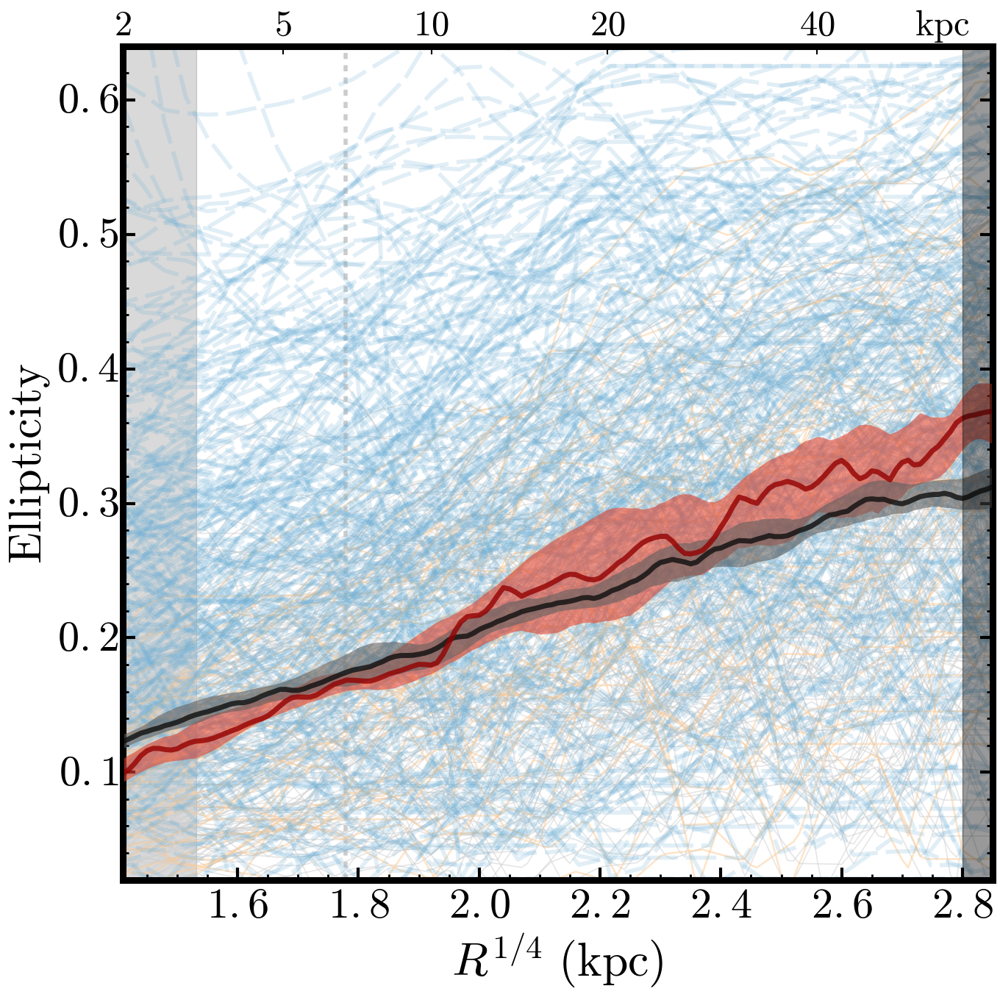

In [98]:
# --------------------------------------------------------------------------------------- #
xmin, xmax =  1.41, 2.85
ymin1, ymax1 = 0.02, 0.64
norm, integrate, normR1 = False, False, 10.0
rsma0 = 1.41
rsma1 = 2.85
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0]

## Setup up figure
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.15, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=42, xlabel=42, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
# ELLIPTICITY PLOT
# --------------------------------------------------------------------------------------- #
## Horiozontal 0.0 line
ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax1 - ymin1) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax1.fill_between([2.8, 4.15], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=cmap2(0.3), alpha=alpha2, linewidth=1.8)
    else:
        np.delete(bm_se, j)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), edgecolor='none', alpha=0.6, zorder=5)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), edgecolor='none', alpha=0.6, zorder=6)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=cmap1(0.95), alpha=0.8, zorder=7)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=cmap2(0.95), alpha=0.8, zorder=8)

# --------------------------------------------------------------------------------------- #
for gal in cat: 
    try:
        ax1.plot(gal['sma2'] ** 0.25, gal['ell_prof'], linestyle='--', c=BLU(0.5), 
                 linewidth=4.0, alpha=0.2, zorder=2, dashes=(30, 8))
    except Exception:
        pass
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
## Legend
ax1.legend(loc=(xLegend1, yLegend1), shadow=True, fancybox=True, 
           numpoints=1, fontsize=32, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Label
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=46)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=45)
# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(ymin1, ymax1)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(xmin, xmax)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=35)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.91, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=35.0, transform=ax1b.transAxes)
# --------------------------------------------------------------------------------------- #
plt.show()

fig.savefig('horizon_ellp_prof_z0.37.pdf', dpi=120)

In [106]:
subCat = cat['col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'm100_aper', 'm10_aper', 'm150_aper']
subCat.write('horizon_logm11.43_2dmass.fits', format='fits')